In [1]:
from __future__ import print_function, division
#Allows relative imports
import os, sys
module_path = os.path.abspath(os.path.join('..'))
if module_path not in sys.path:
    sys.path.append(module_path)
#imports from files
from src.preprocessing import *
from src.VAE_train import *
from src.vautoencoders import *
from src.loss_metrics import *
from src.pickling import *
from src.datasets import *

import pandas as pd 
import numpy as np
import math

import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.utils.data import Dataset, DataLoader

#checking gpu status
if torch.cuda.is_available():
    device = torch.device('cuda')
    print("Using : {}".format(device))
else:
    device = torch.device('cpu')
    print("Using : {}".format(device))
    
#Plot and stuff
import seaborn as sns
import matplotlib as mpl
import matplotlib.pyplot as plt
mpl.rcParams['figure.dpi']= 300
sns.set_style('darkgrid')


# Ignore warnings)
import warnings
warnings.filterwarnings("ignore")
    
%load_ext autoreload
%autoreload 2

Using : cuda


# Embeddings visualization:

In [2]:
#Reloading data
emerson = pd.read_csv('../training_data_new/emerson_raw/batch1/emerson_batch1_626hla_parsed_tagged.tsv', sep='\t')
sample_tags = pd.read_csv('../training_data_new/emerson_raw/batch1/emerson_batch1_sampletags.tsv', sep ='\t')



KeyboardInterrupt: 

In [5]:
#Reloading model
vae = VAE_tune(latent_dim = 50, aa_dim = 25, act = nn.SELU())
chkpt = torch.load('./VAE-testCYCLICbeta_50LatDim_40Epochs_05std_2x173-07-weighted0.5_latent50_SELUlr6.670000e-04.pth.tar')
vae.load_state_dict(chkpt['state_dict'])

<All keys matched successfully>

#### Viz & computation functions here

##### query

In [7]:
def mask_seq(df):
    df['X']= 'X'
    df['masked_vj'] = 4*'X'+df['amino_acid'].str.slice(4,-4,1)+4*'X'# Getting X in V/J regions
    df['masked_centre'] = df['amino_acid'].str.slice(0,4,1)+df['X'].str.repeat(df['amino_acid'].str.len()-8)+df['amino_acid'].str.slice(-4,-1,1)+'F'
    df.drop(columns='X', inplace=True)
    return df

In [8]:
def get_patients(n=2, show =True):
    print(f'\t Getting {n} patients')
    fn = np.random.choice(sample_tags.filename.unique(), n)
    patients_queried = emerson.query('filename in @fn')
    print(f'Length of df {len(patients_queried)}')
    if show == True:
        display(sample_tags.query('filename in @fn')[['filename','age', 'sex', 'race', 'hla_a1',
                                                      'hla_a2', 'hla_b1', 'hla_b2', 'class']])
        aas = patients_queried.query('filename==@fn[0]').amino_acid.values
        print("Total shared : ", len(patients_queried.query('filename==@fn[1] and amino_acid in @aas')))
    return patients_queried.query('len>10 and len<=23')

def get_topk(df, topk=2500, verbose=True):
    print(f'\t Getting the top {topk}')
    top = df.sort_values('frequency', ascending=False)\
            .groupby('filename').head(topk)
    fn_ = top.filename.unique()
    if verbose:
        aas = top.query("filename in @fn_[1]").amino_acid.values
        len_shared = len(top.query('filename==@fn_[0] and amino_acid in @aas'))
        print(f"# Shared in top {topk} seqs : {len_shared}")
        return top, len_shared
    else:
        return top

##### Reduc/plot

In [37]:
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA
from umap import UMAP

def get_reduc(df, model, reduc='TSNE', positional=False, n_c = 2):
    if reduc == 'TSNE':
        reducer = TSNE(n_components = n_c, random_state=42)
    elif reduc == 'PCA':
        reducer = PCA(n_components = n_c, random_state = 42)
    elif reduc == 'UMAP':
        reducer = UMAP(n_components = n_c, random_state=42)
        
    model_device = next(model.children())[0].weight.device
    print('\t Onehot-encoding.')
    model.eval()
    onehot = onehot_batch(df.amino_acid.values, weighted = 0.5,
                          max_len = 23, positional = True)
    onehot = onehot.to(model_device)
    print(f'\t Embedding {onehot.shape[0]} sequences.')
    with torch.no_grad():
        mu, logvar = model.encode(onehot)
        embedding = model.reparameterise(mu, logvar).detach().cpu().numpy()

    print(f'\t Fitting {reduc}.')
    results = reducer.fit_transform(embedding)
    print('\t Waiting on plotting.')
    for i in range(results.shape[1]):
        df[f'{reduc}_'+str(i+1)] = results[:,i]
    return df

def plot_reduc(df, hue, name, reduc = 'TSNE', palette = 'seismic_r', comp = True):
    unique = len(df[hue].unique())
    sns.set_palette(palette, unique)
    MARKERS = ['X','P','D','s','o','*']
    if unique > 6:
        MARKERS = ['X']*unique
    vars_= [z for z in df.columns if z.startswith(reduc)]
    g = sns.PairGrid(df, x_vars = vars_,
                     y_vars = vars_,
                     diag_sharey=False, hue=hue,
                     hue_kws = {'markers':MARKERS[:unique]})
    if comp == True : 
        title = f'{name} TCR, {reduc} with {len(vars_)} components'
        adjust = 0.91
    elif comp == False:
        classes = '//'.join(sample_tags.query('filename in @df.filename.unique()')['class'].values)
        title = f'VAE : {name} TCR, {reduc} with {len(vars_)} components\n'\
                   f'HLA Classes : {classes}'
        adjust = 0.89
        
    g.fig.suptitle(title, fontweight='bold')
    g.fig.subplots_adjust(top=adjust)
    
    g.map_lower(sns.scatterplot,  alpha=0.8, size = df[hue],
                markers= MARKERS[:unique], style = df[hue],
                sizes=[3]*unique)
    g.map_upper(sns.kdeplot, levels = 8, alpha = 0.75)
    g.map_diag(sns.kdeplot)
    g.add_legend()
    

def pipeline(model, n = 2, n_comp = 2, top_k=2500, positional = True, comp = True,
             reduc = 'TSNE', hue='filename', name='', palette='seismic_r'):
    
    pats = get_patients(n)
    topk, len_shared = get_topk(pats, top_k)
    results = get_reduc(topk, model, reduc=reduc, positional = positional, n_c = n_comp)
    plot_reduc(results, hue=hue, reduc = reduc,
              name = name+f'Top {top_k}, with {len_shared} shared', 
              palette=palette, comp = comp)
    names = ('-').join([x.split('.tsv')[0] for x in pats.filename.unique()])
    plt.savefig(f'./VAE/{reduc}/'+name+'top_'+str(top_k)+names+f'_with_{str(len_shared)}_shared_{reduc}.jpg',
                dpi = 300)
    return pats, results, names.split('-')

def pipeline_alt(model, df, n_comp = 2, top_k=2500, positional = False, 
                 reduc = 'TSNE',
                 hue='filename', name='', palette='seismic_r', comp = True):
    topk, len_shared = get_topk(df, top_k)
    results = get_reduc(topk, model, reduc, positional = positional, n_c = n_comp)
    plot_reduc(results, hue=hue, reduc = reduc,
              name = name+f'Top {top_k}, with {len_shared} shared', 
              palette=palette, comp = comp)
    names = ('-').join([x.split('.tsv')[0] for x in df.filename.unique()])
    plt.savefig(f'./VAE/{reduc}/'+name+'top_'+str(top_k)+names+f'_with_{str(len_shared)}_shared_{reduc}.jpg',
                dpi = 300)
    return df, results, names.split('-')

### DeepCAT dataset

In [25]:
normal = pd.read_csv('./normal.txt', header=None)
normal['type'] = 'normal'
tumor = pd.read_csv('./tumor.txt', header=None)
tumor['type'] = 'tumor'

df = normal.append(tumor)
df = df.rename(columns={0:'amino_acid'}).query('amino_acid.str.len() > 10 and amino_acid.str.len() <= 23')
df = get_reduc(df, vae, reduc = 'umap'.upper())
df = get_reduc(df, vae, reduc = 'tsne'.upper())

	 Onehot-encoding.
	 Embedding 99700 sequences.
	 Fitting UMAP.
	 Waiting on plotting.
	 Onehot-encoding.
	 Embedding 99700 sequences.
	 Fitting TSNE.
	 Waiting on plotting.


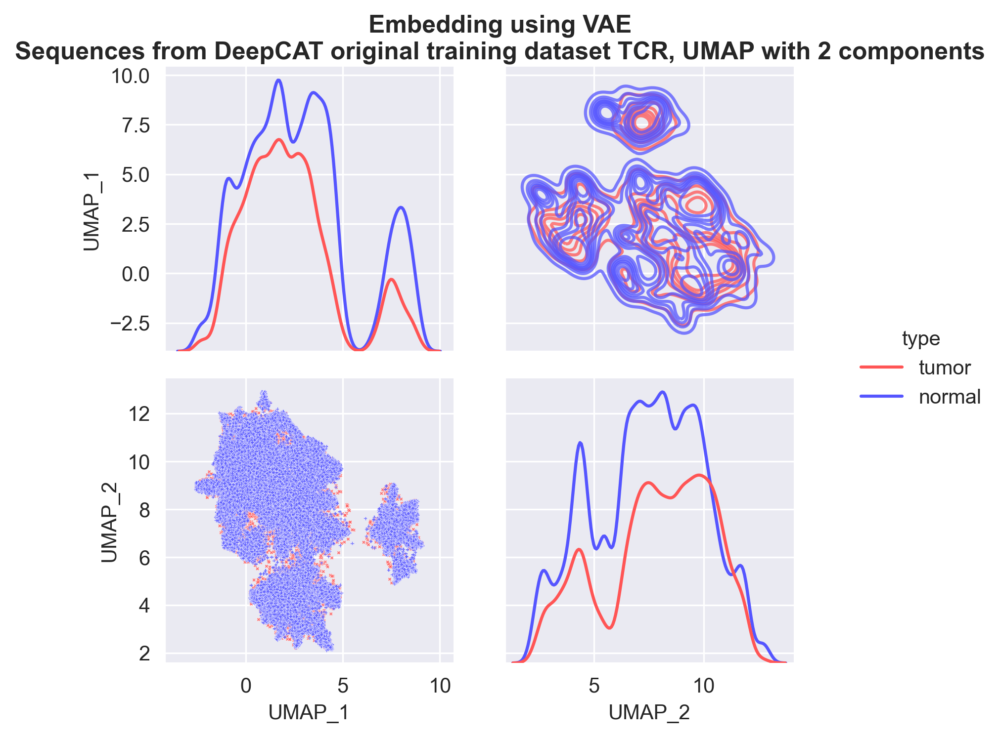

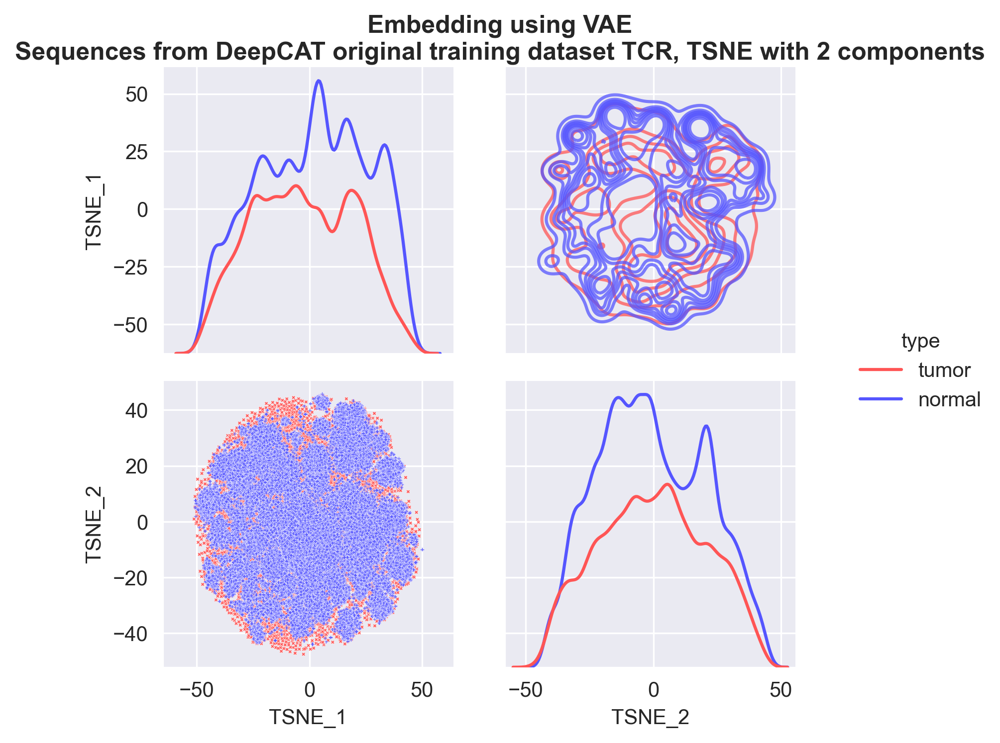

In [28]:
plot_reduc(df.sort_values('type',ascending=False), hue='type', reduc='UMAP', palette = 'seismic_r',
          name = 'Embedding using VAE\nSequences from DeepCAT original training dataset')
plt.savefig('./VAE/deepcat_UMAP.jpg', dpi=300)
plot_reduc(df.sort_values('type',ascending=False), hue='type', reduc='TSNE', palette = 'seismic_r',
          name = 'Embedding using VAE\nSequences from DeepCAT original training dataset')
plt.savefig('./VAE/deepcat_TSNE.jpg', dpi=300)


### random 3

	 Getting 2 patients
Length of df 79760


,filename,age,sex,race,hla_a1,hla_a2,hla_b1,hla_b2,class
551,HIP14153.tsv,60,Female,Caucasian,A23,A68,B40,B44,A23-A68-B40-B44
588,HIP14240.tsv,23,Female,Caucasian,A01,Unknown,B08,B35,A01-B08-B35


Total shared :  1137
	 Getting the top 5000
# Shared in top 5000 seqs : 23
	 Onehot-encoding.
	 Embedding 10000 sequences.
	 Fitting TSNE.
	 Waiting on plotting.
	 Getting 2 patients
Length of df 79657


,filename,age,sex,race,hla_a1,hla_a2,hla_b1,hla_b2,class
56,HIP01313.tsv,32,Male,Unknown,A01,A24,B07,B08,A01-A24-B07-B08
309,HIP12034.tsv,2,Female,Caucasian,A24,Unknown,B07,B51,A24-B07-B51


Total shared :  1354
	 Getting the top 5000
# Shared in top 5000 seqs : 51
	 Onehot-encoding.
	 Embedding 10000 sequences.
	 Fitting UMAP.
	 Waiting on plotting.
	 Getting 2 patients
Length of df 79825


,filename,age,sex,race,hla_a1,hla_a2,hla_b1,hla_b2,class
19,HIP00813.tsv,32,Male,Caucasian,A02,Unknown,B51,Unknown,A02-B51
105,HIP03111.tsv,26,Male,Caucasian,A01,A29,B08,B51,A01-A29-B08-B51


Total shared :  1073
	 Getting the top 5000
# Shared in top 5000 seqs : 46
	 Onehot-encoding.
	 Embedding 10000 sequences.
	 Fitting PCA.
	 Waiting on plotting.
	 Getting 2 patients
Length of df 79760


,filename,age,sex,race,hla_a1,hla_a2,hla_b1,hla_b2,class
164,HIP05398.tsv,18,Male,Caucasian,A03,Unknown,B07,B51,A03-B07-B51
530,HIP14096.tsv,42,Female,Caucasian,A02,A80,B15,B58,A02-A80-B15-B58


Total shared :  1124
	 Getting the top 5000
# Shared in top 5000 seqs : 43
	 Onehot-encoding.
	 Embedding 10000 sequences.
	 Fitting TSNE.
	 Waiting on plotting.
	 Getting 2 patients
Length of df 78432


,filename,age,sex,race,hla_a1,hla_a2,hla_b1,hla_b2,class
139,HIP04464.tsv,17,Female,Unknown,A26,A28,B38,B61,A26-A28-B38-B61
289,HIP10817.tsv,26,Male,Caucasian,A02,A03,B60,B62,A02-A03-B60-B62


Total shared :  1067
	 Getting the top 5000
# Shared in top 5000 seqs : 30
	 Onehot-encoding.
	 Embedding 10000 sequences.
	 Fitting UMAP.
	 Waiting on plotting.
	 Getting 2 patients
Length of df 75109


,filename,age,sex,race,hla_a1,hla_a2,hla_b1,hla_b2,class
335,HIP13193.tsv,Unknown,Male,Unknown,A02,A29,B14,B45,A02-A29-B14-B45
490,HIP13994.tsv,64,Male,Caucasian,A02,Unknown,B07,B44,A02-B07-B44


Total shared :  1062
	 Getting the top 5000
# Shared in top 5000 seqs : 29
	 Onehot-encoding.
	 Embedding 10000 sequences.
	 Fitting PCA.
	 Waiting on plotting.
	 Getting 2 patients
Length of df 49282


,filename,age,sex,race,hla_a1,hla_a2,hla_b1,hla_b2,class
285,HIP10759.tsv,46,Female,Caucasian,A02,A32,B15,B35,A02-A32-B15-B35
535,HIP14110.tsv,42,Female,Caucasian,A01,A02,B08,B51,A01-A02-B08-B51


Total shared :  270
	 Getting the top 5000
# Shared in top 5000 seqs : 39
	 Onehot-encoding.
	 Embedding 10000 sequences.
	 Fitting TSNE.
	 Waiting on plotting.
	 Getting 2 patients
Length of df 79756


,filename,age,sex,race,hla_a1,hla_a2,hla_b1,hla_b2,class
282,HIP10726.tsv,25,Female,Caucasian,A02,A03,B44,B52,A02-A03-B44-B52
467,HIP13945.tsv,51,Male,Caucasian,A01,A02,B08,B51,A01-A02-B08-B51


Total shared :  1110
	 Getting the top 5000
# Shared in top 5000 seqs : 29
	 Onehot-encoding.
	 Embedding 10000 sequences.
	 Fitting UMAP.
	 Waiting on plotting.
	 Getting 2 patients
Length of df 79764


,filename,age,sex,race,hla_a1,hla_a2,hla_b1,hla_b2,class
483,HIP13981.tsv,44,Male,Caucasian,A02,A03,B07,B15,A02-A03-B07-B15
567,HIP14194.tsv,46,Female,Caucasian,A02,A03,B07,B27,A02-A03-B07-B27


Total shared :  1426
	 Getting the top 5000
# Shared in top 5000 seqs : 27
	 Onehot-encoding.
	 Embedding 10000 sequences.
	 Fitting PCA.
	 Waiting on plotting.


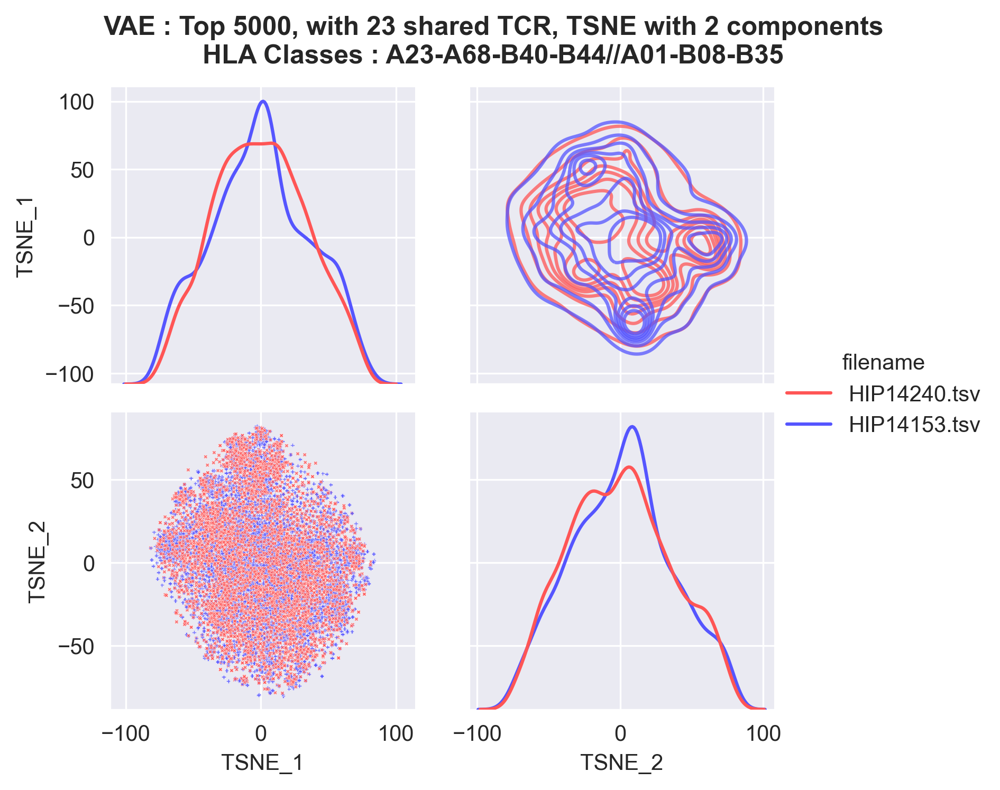

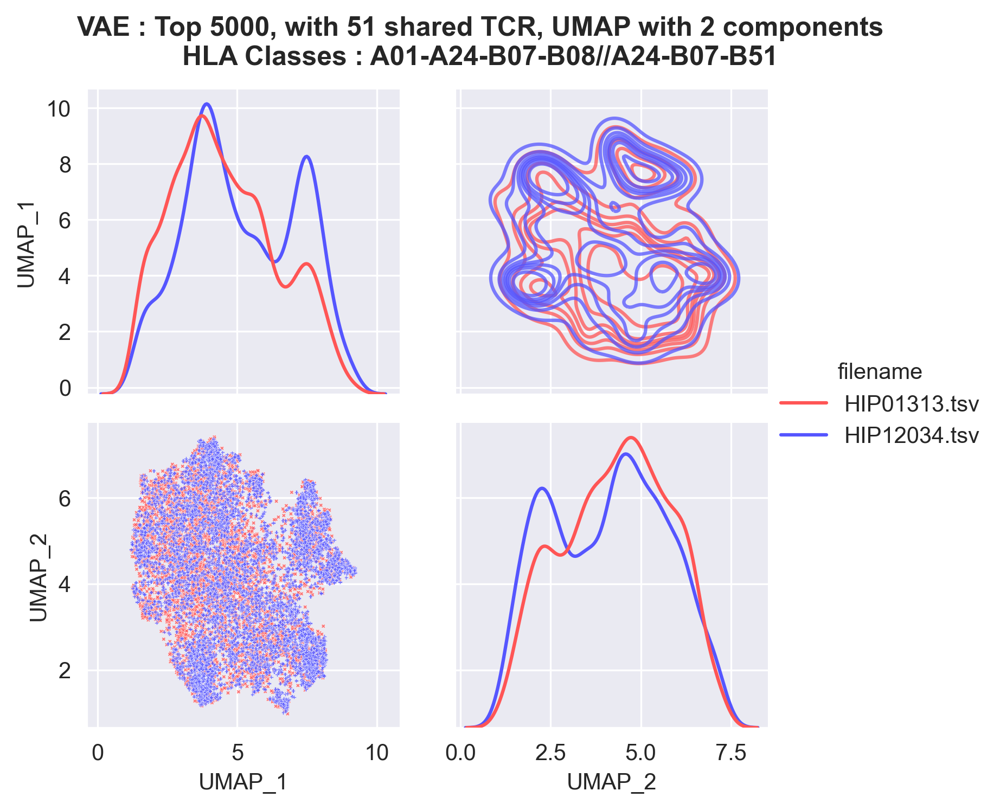

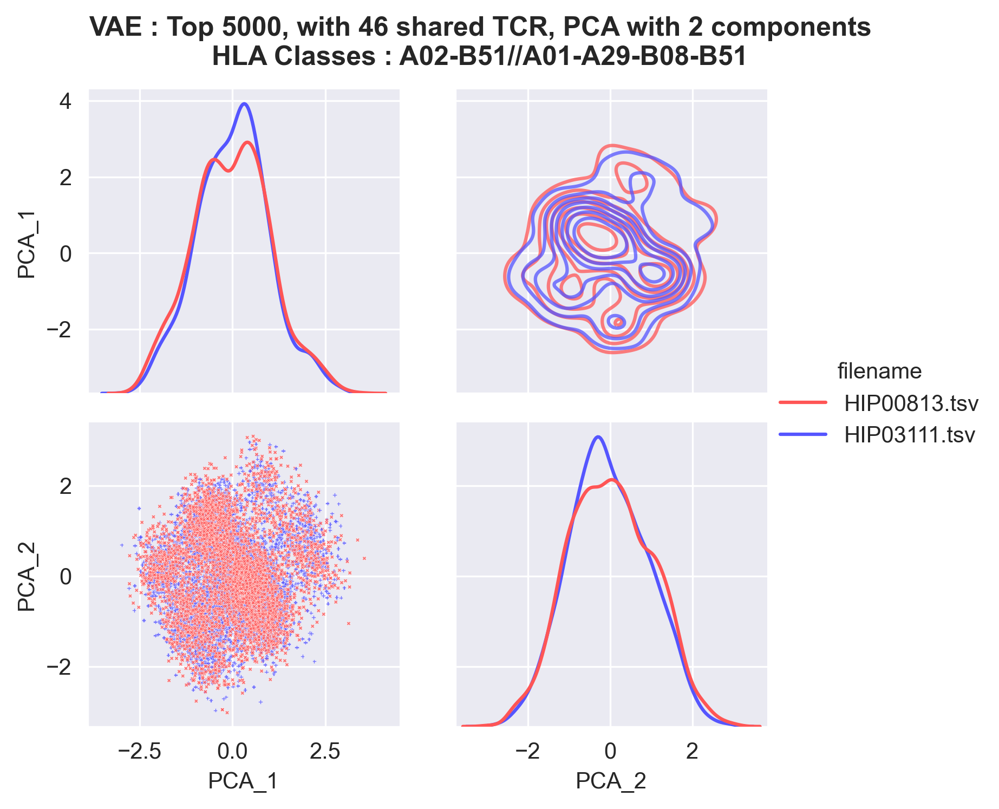

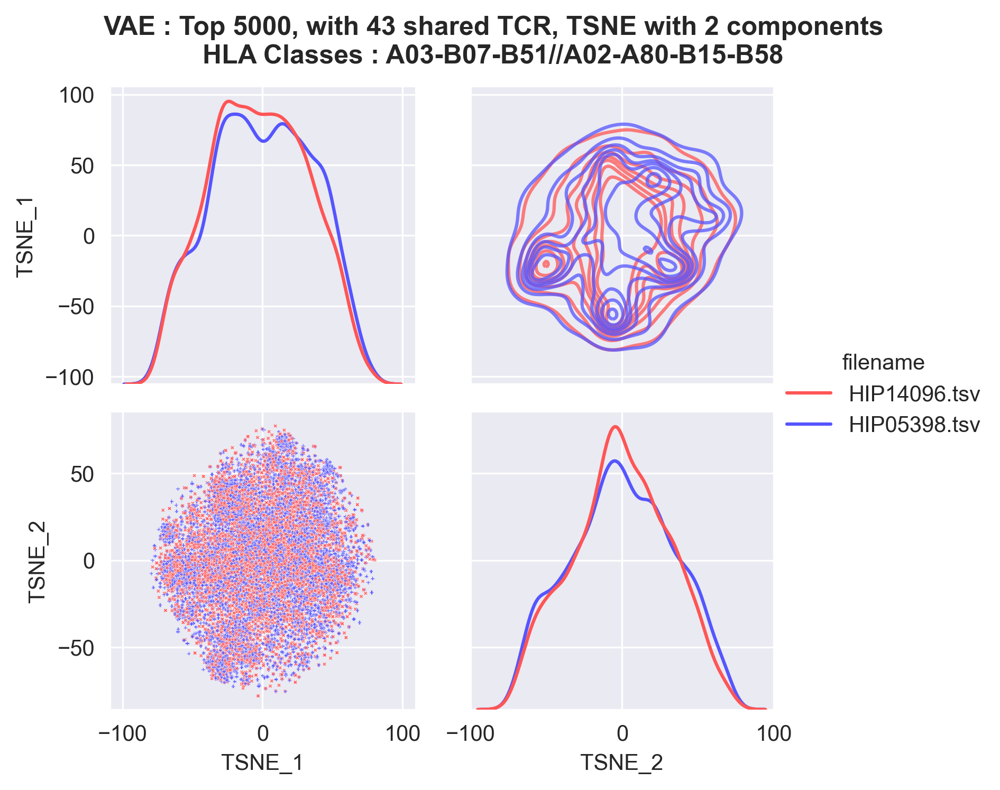

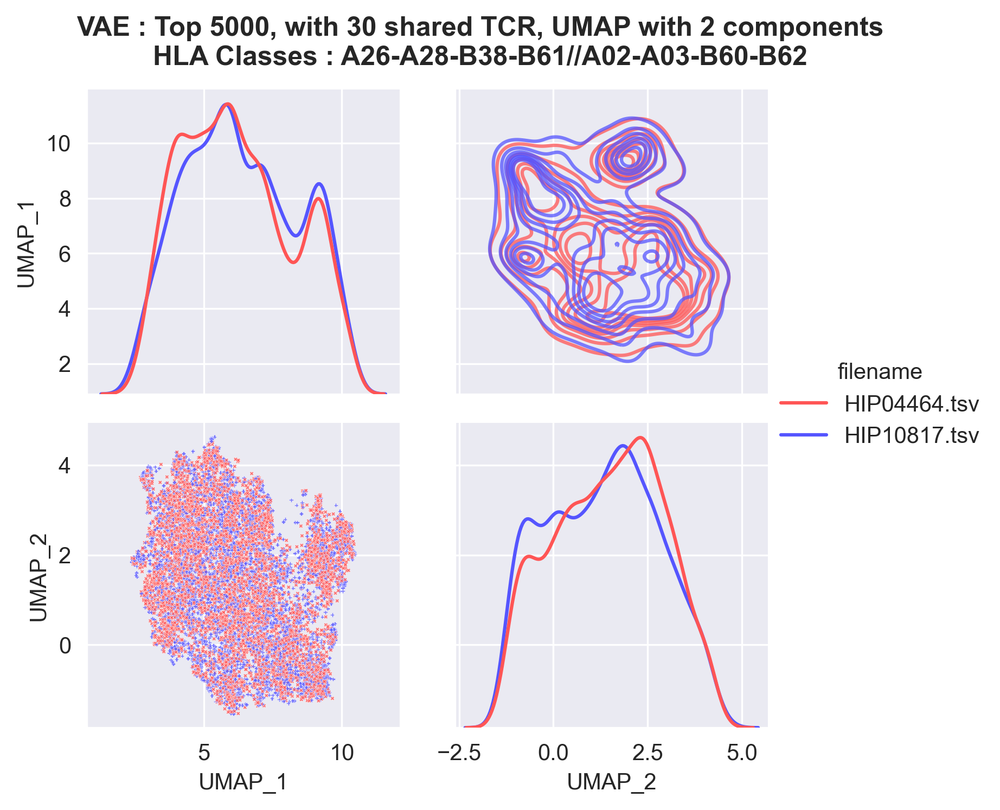

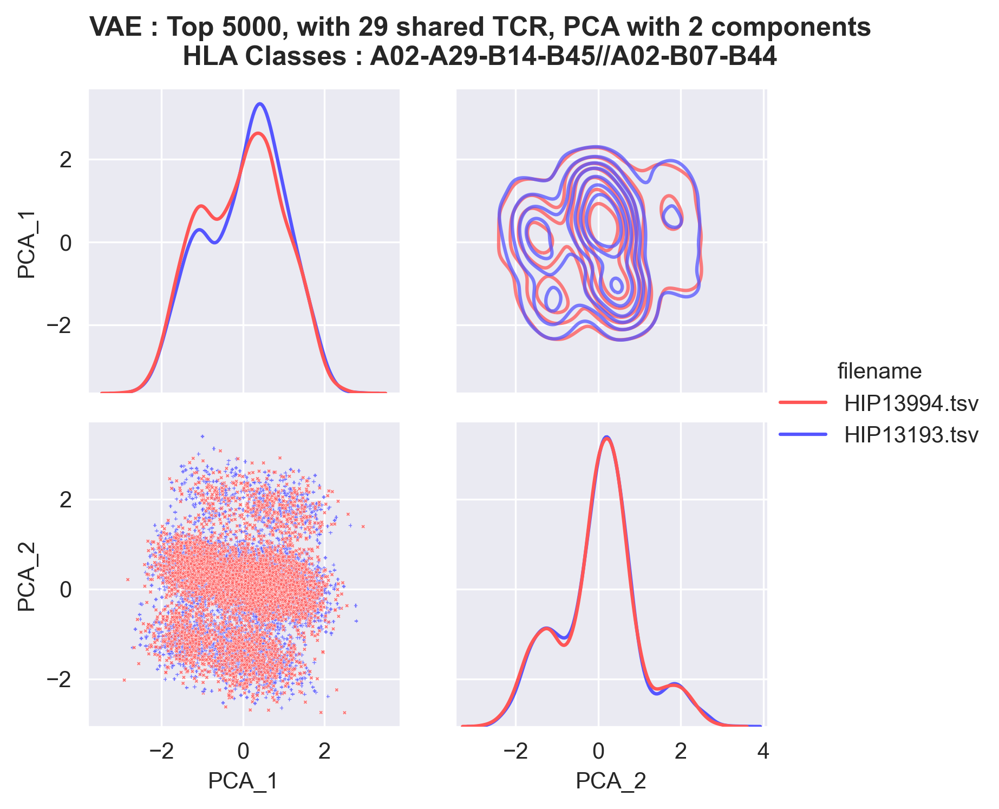

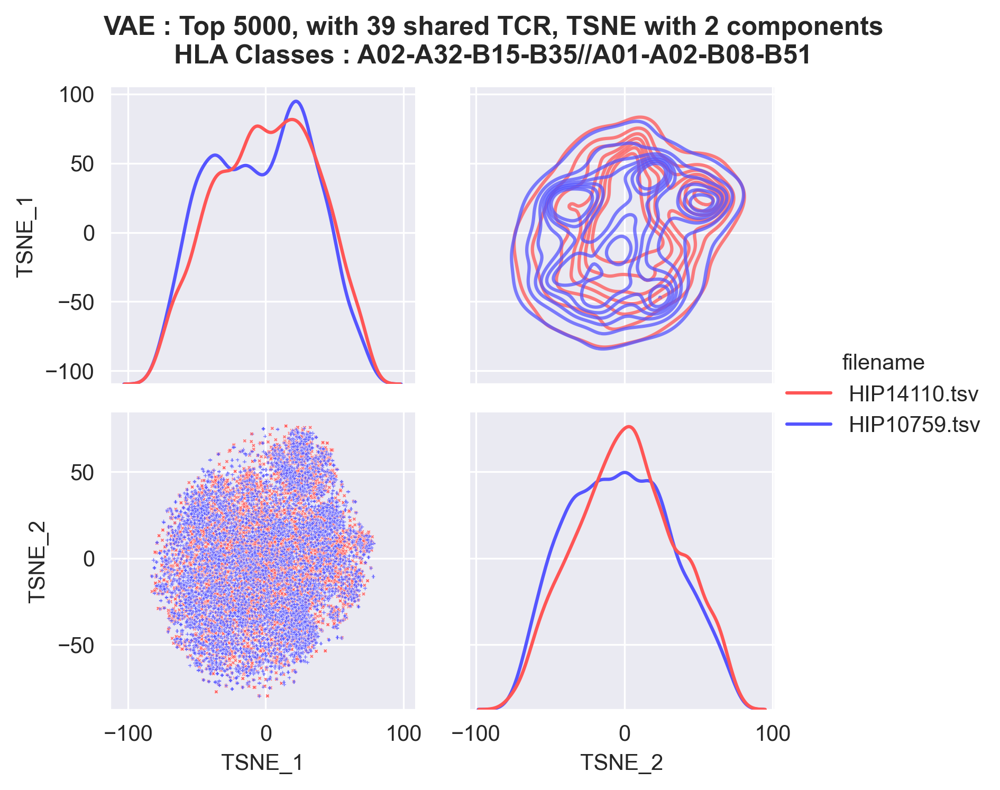

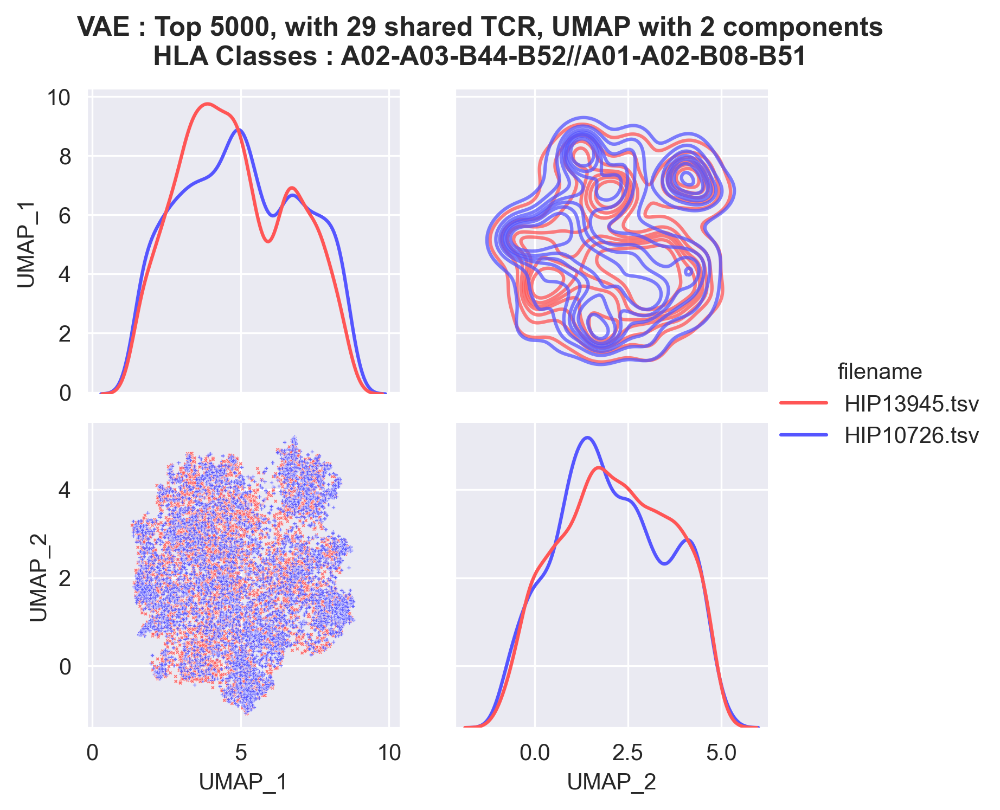

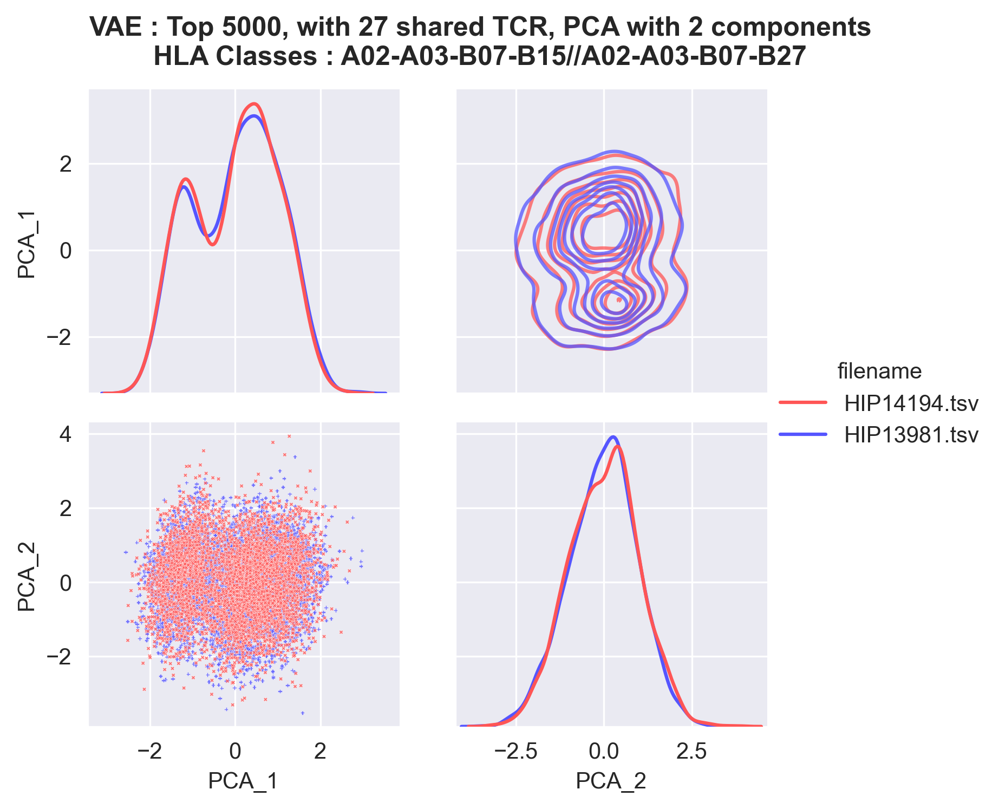

In [38]:
#Random comparisons with normal model
for i in range(3):
    for reduc in ['TSNE','UMAP','PCA']:
        _,_, filenames = pipeline(vae, 2, top_k=5000, reduc=reduc,
                                  positional = True, comp = False,
                                  hue = 'filename', palette='seismic_r')

	 Getting the top 2500
# Shared in top 2500 seqs : 8
	 Onehot-encoding.
	 Embedding 15000 sequences.
	 Fitting TSNE.
	 Waiting on plotting.
	 Getting the top 2500
# Shared in top 2500 seqs : 8
	 Onehot-encoding.
	 Embedding 15000 sequences.
	 Fitting TSNE.
	 Waiting on plotting.
	 Getting the top 2500
# Shared in top 2500 seqs : 15
	 Onehot-encoding.
	 Embedding 12500 sequences.
	 Fitting TSNE.
	 Waiting on plotting.
	 Getting the top 2500
# Shared in top 2500 seqs : 8
	 Onehot-encoding.
	 Embedding 12500 sequences.
	 Fitting TSNE.
	 Waiting on plotting.
	 Getting the top 2500
# Shared in top 2500 seqs : 18
	 Onehot-encoding.
	 Embedding 10000 sequences.
	 Fitting TSNE.
	 Waiting on plotting.
	 Getting the top 2500
# Shared in top 2500 seqs : 14
	 Onehot-encoding.
	 Embedding 10000 sequences.
	 Fitting TSNE.
	 Waiting on plotting.
	 Getting the top 2500
# Shared in top 2500 seqs : 12
	 Onehot-encoding.
	 Embedding 10000 sequences.
	 Fitting TSNE.
	 Waiting on plotting.


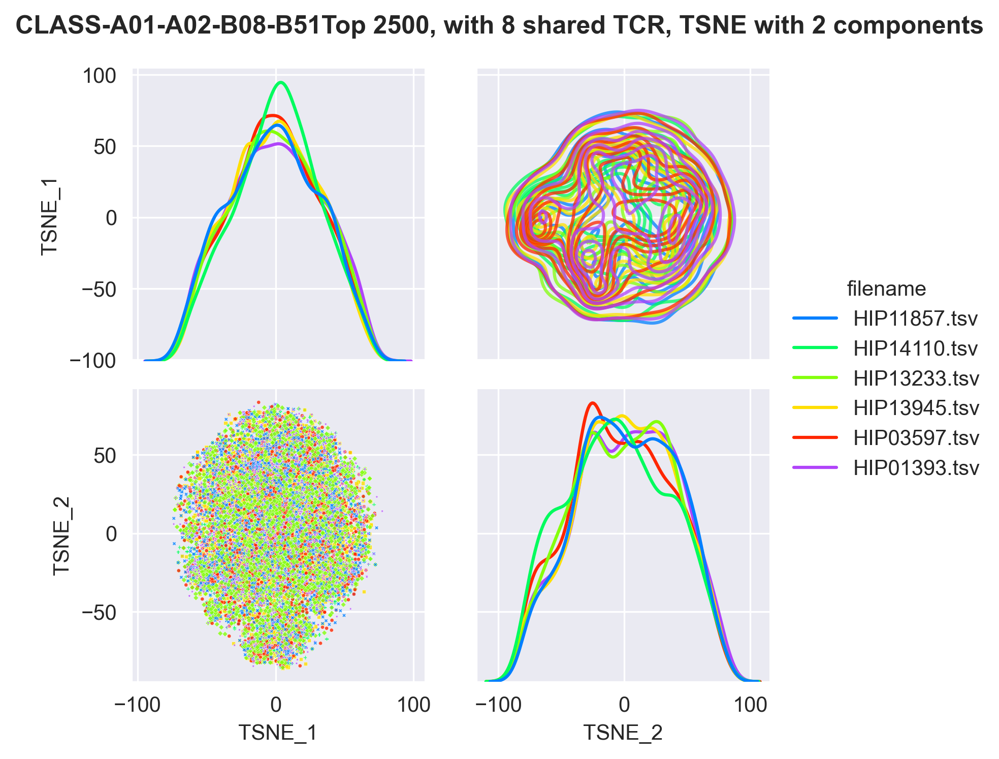

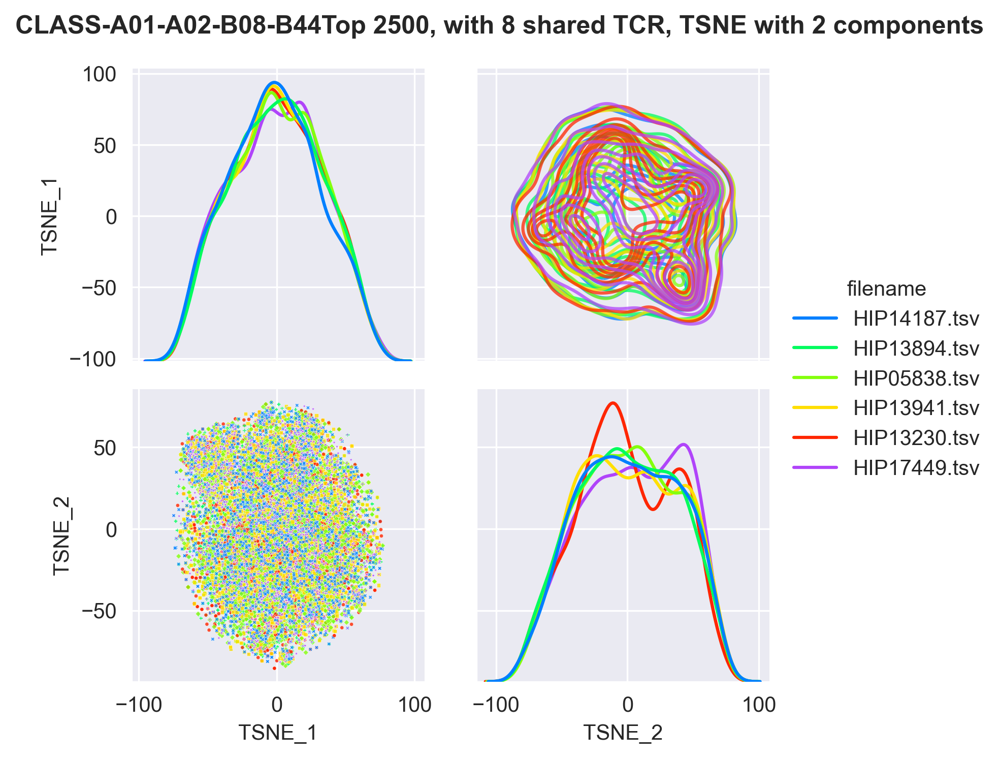

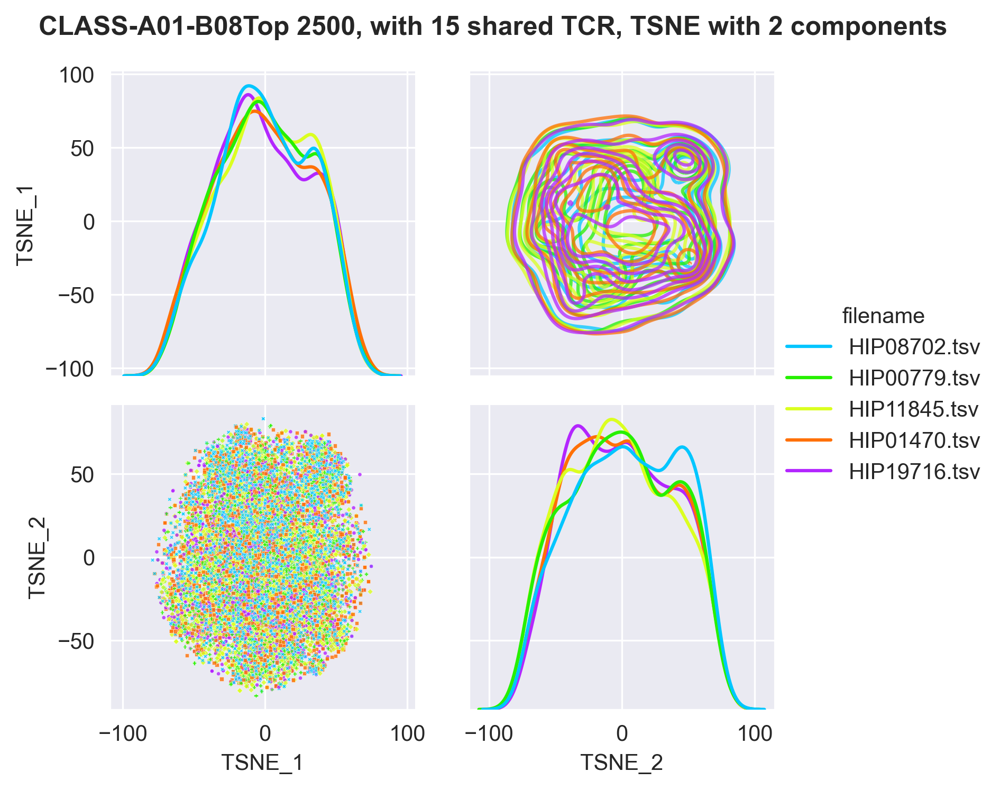

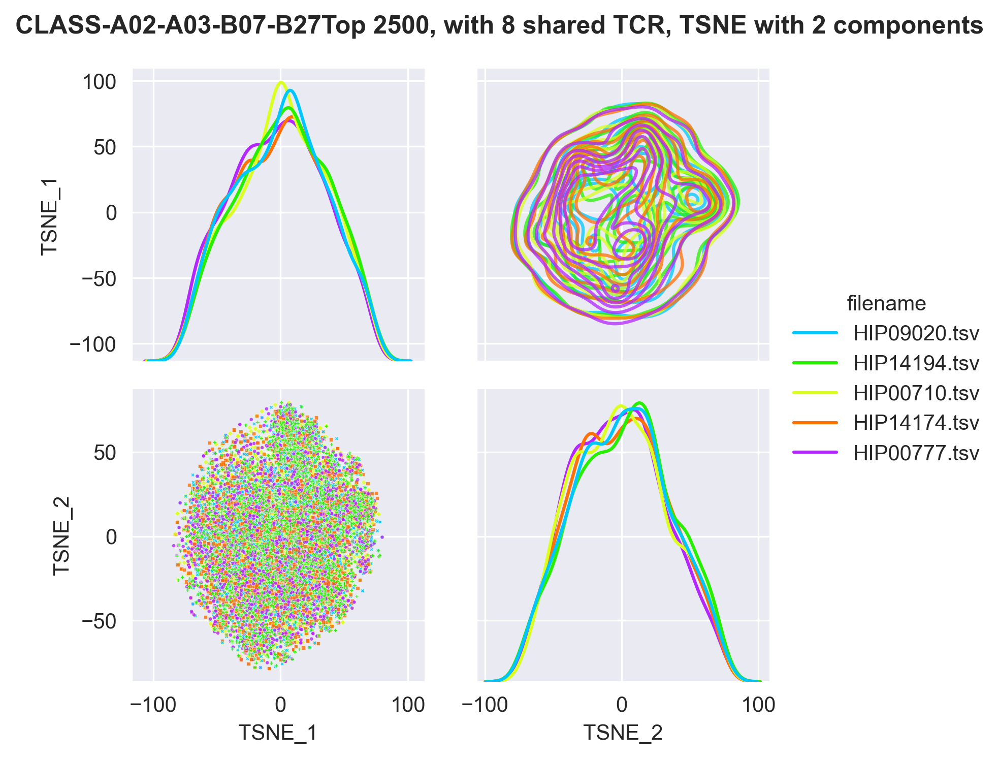

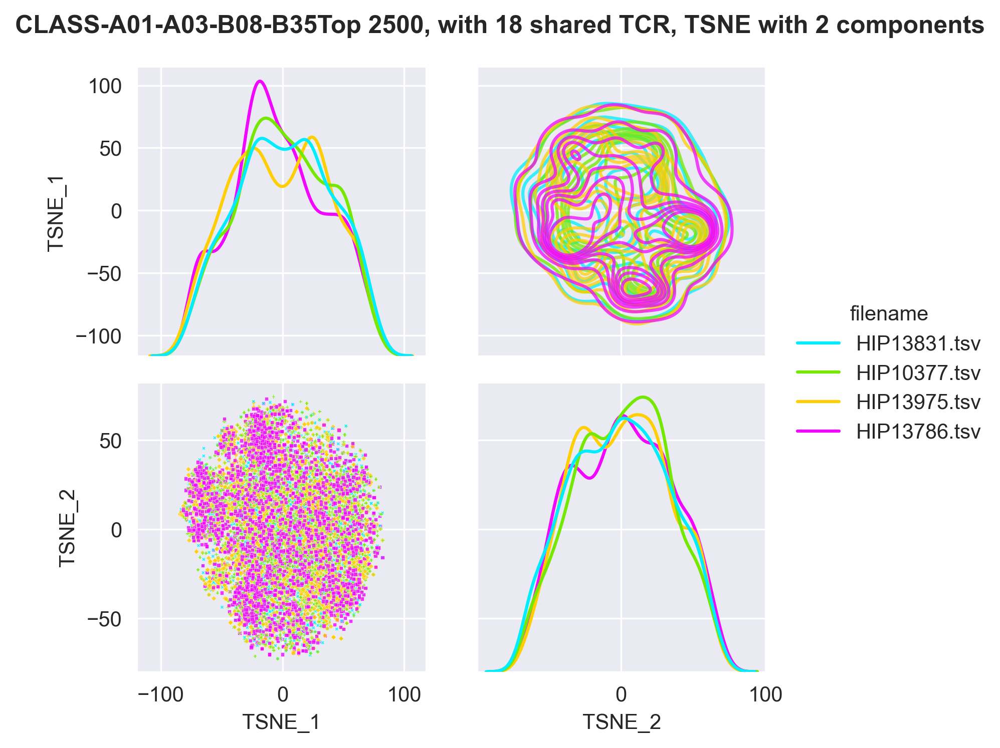

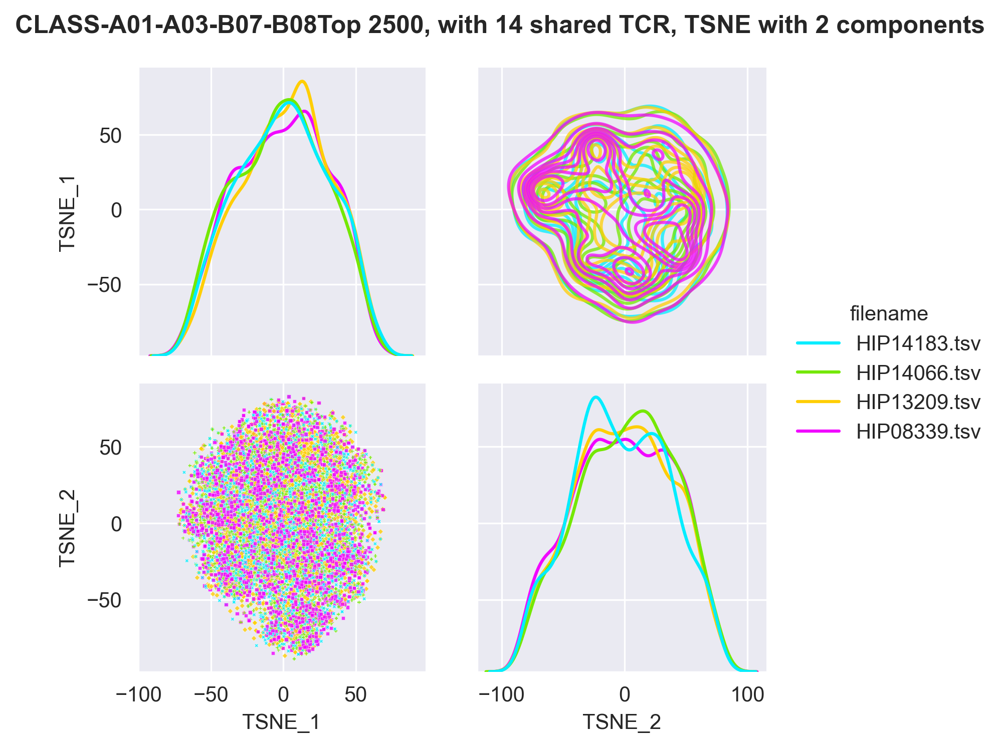

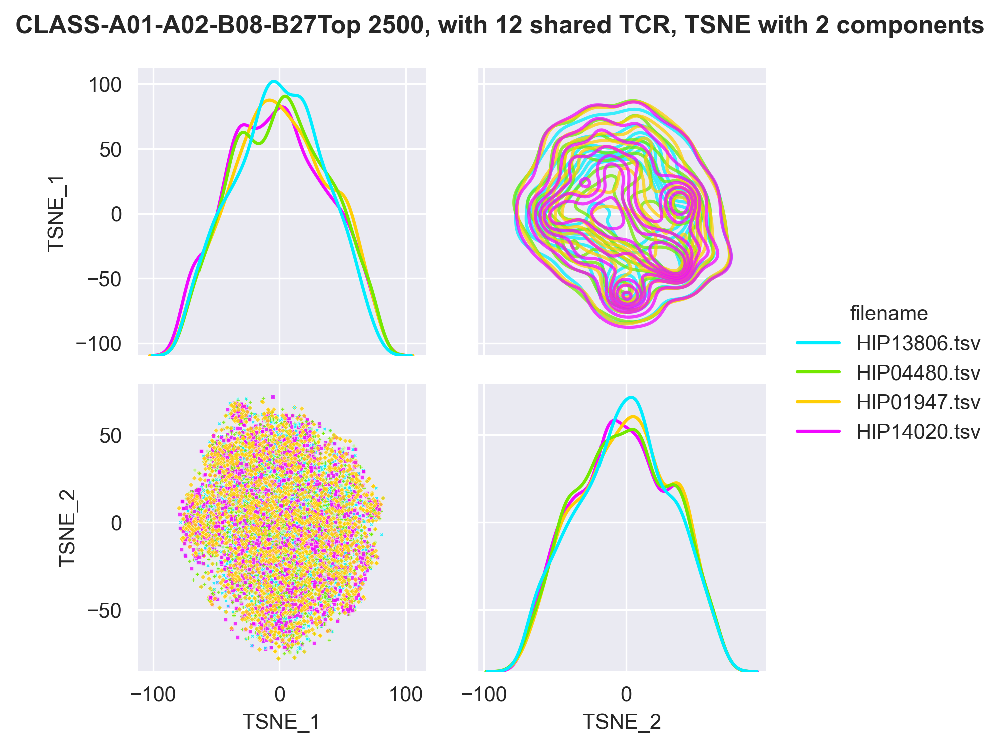

In [40]:
#Comparing patients with same HLA genotype
shared_classes = sample_tags.groupby('class').count().sort_values('filename',ascending=False).head(9).index[:7]
for c in shared_classes:
    fns = sample_tags.query('`class`== @c').filename.unique()
    sub = emerson.query('filename in @fns and len>10 and len <=23')
    _ =pipeline_alt(vae, sub, top_k = 2500, reduc = 'TSNE',
                    comp= True,
                    hue = 'filename', name = 'CLASS-'+c,
                    palette = 'gist_ncar')

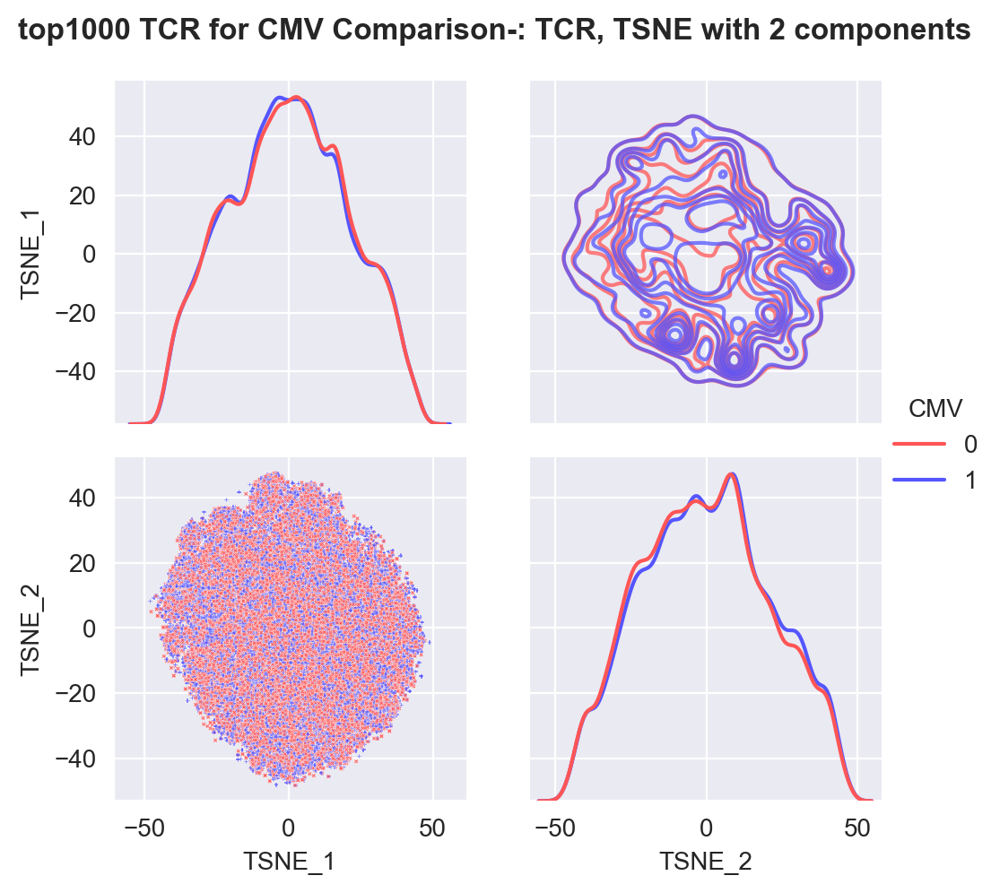

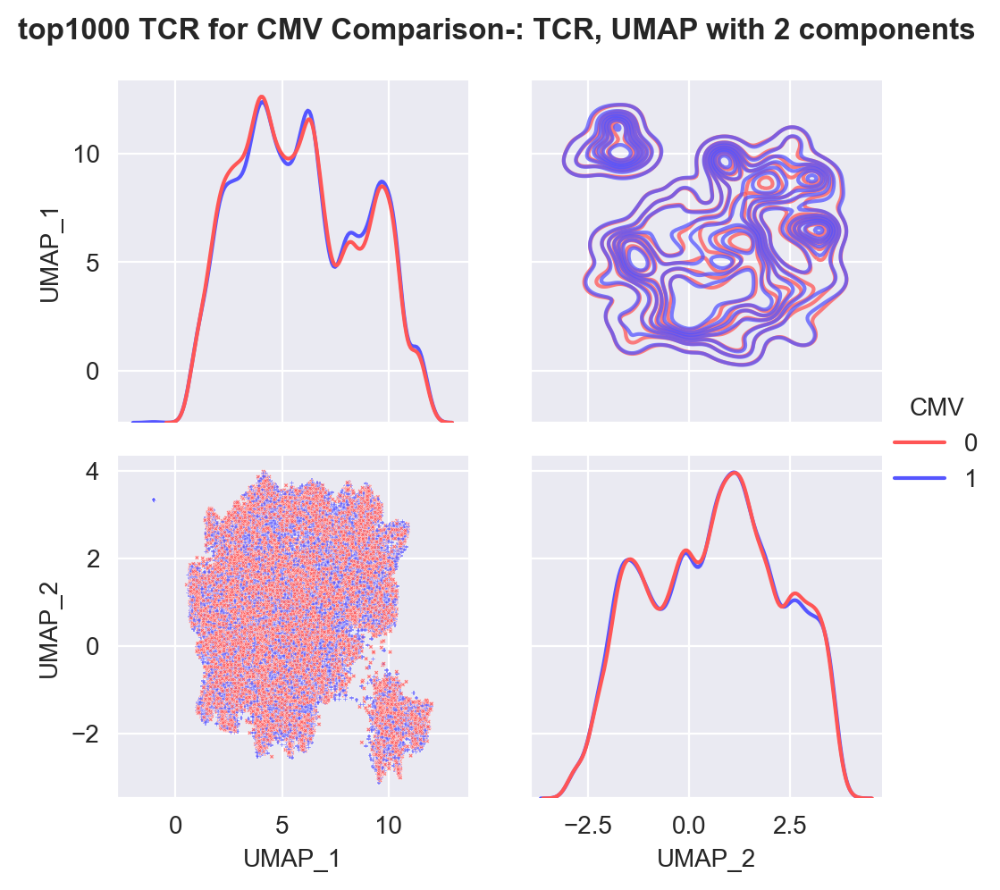

In [75]:
# COMPARING TOP 500
fn_true  = sample_tags.query('true_cmv=="1"').sample(50).filename.values
fn_false = sample_tags.query('true_cmv=="0"').sample(50).filename.values
fn_total = np.append(fn_true, fn_false)
sub = get_topk(emerson.query('filename in @fn_total and len > 10 and len <= 23'), 1000, verbose= False)
sub = get_reduc(sub, vae, reduc = 'TSNE', positional = False)
sub = get_reduc(sub, vae, reduc = 'UMAP', positional = False)
plot_reduc(sub, hue='true_cmv', name='top1000 TCR for CMV Comparison-:', reduc='TSNE',
          comp = True, palette = 'seismic_r')
plt.savefig('./VAE/cmv_comparison/VAE_top1k_50patients.jpg', dpi=300)

plot_reduc(sub, hue='true_cmv', name='top1000 TCR for CMV Comparison-:', reduc='UMAP',
          comp = True, palette = 'seismic_r')
plt.savefig('./VAE/cmv_comparison/VAE_top1k_50patients.jpg', dpi=300)

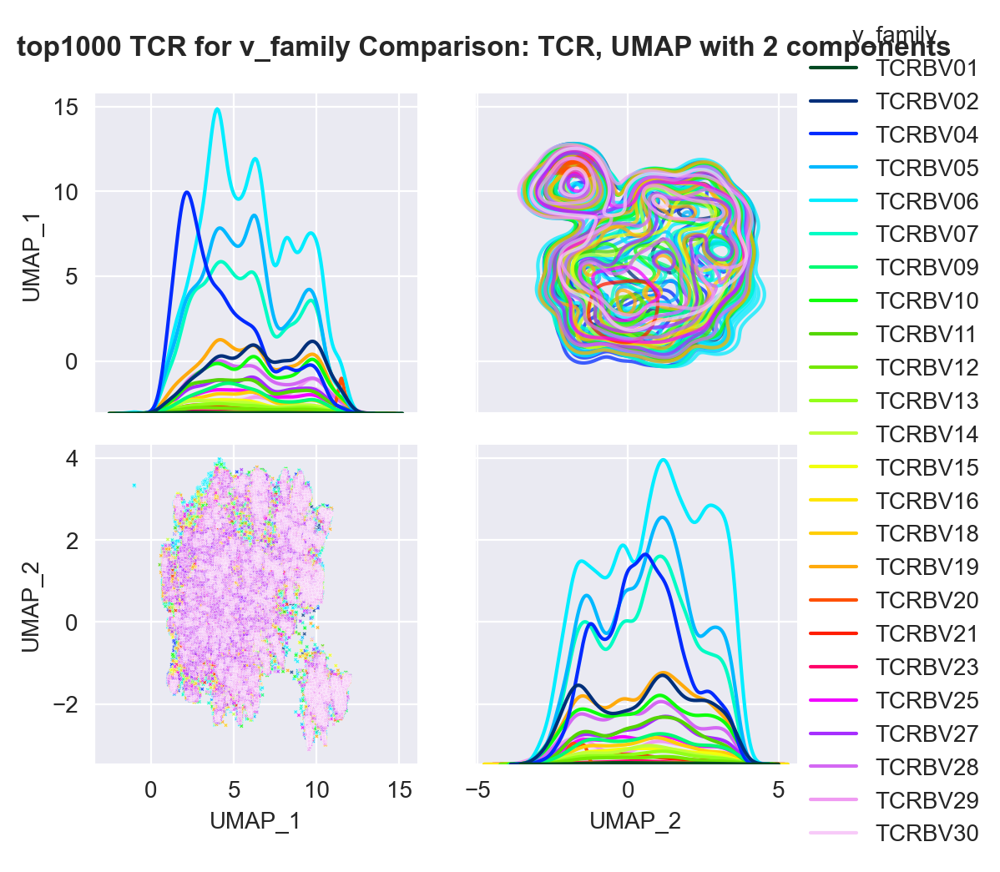

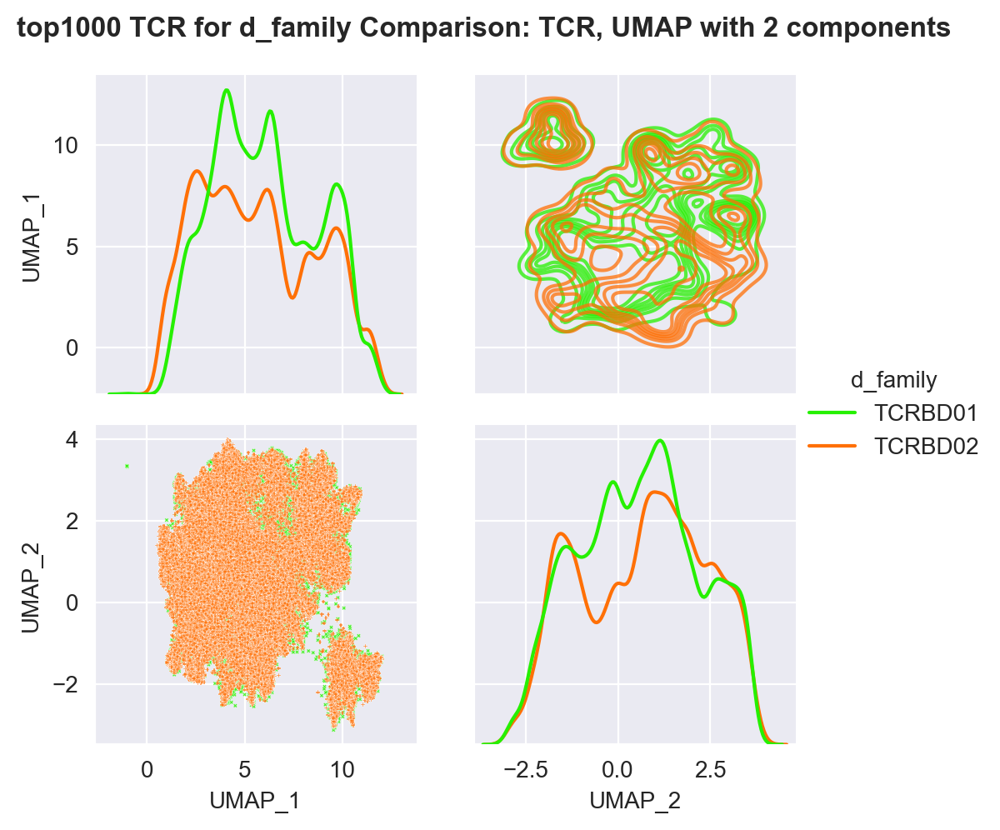

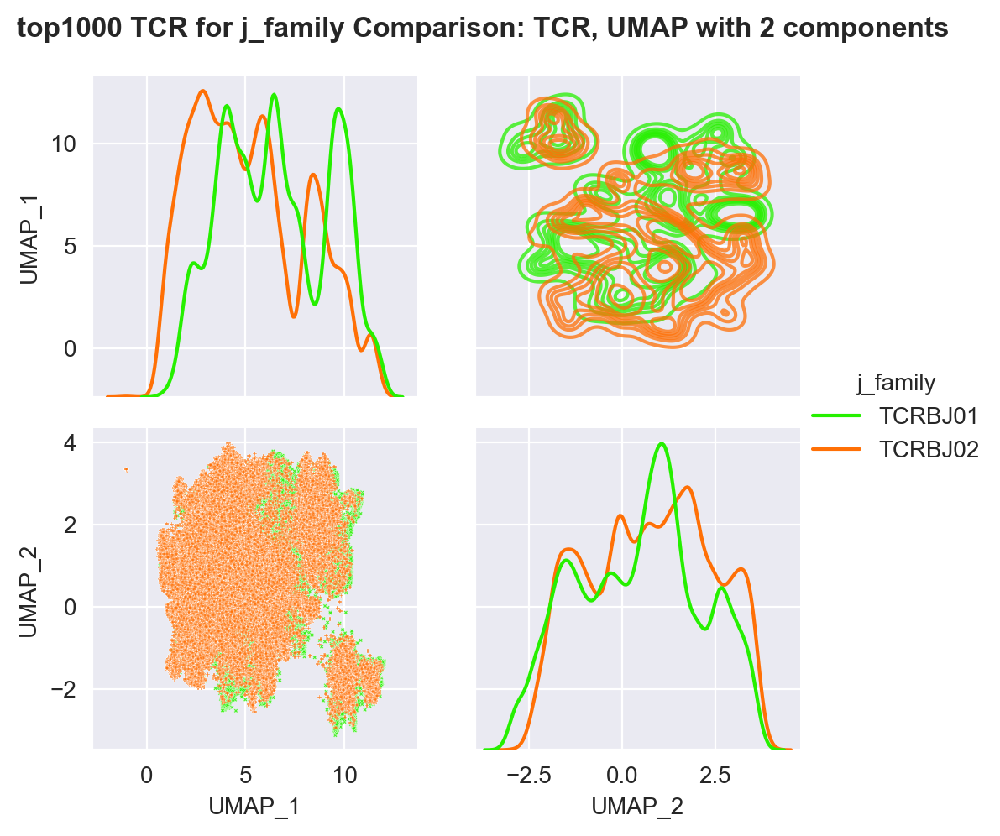

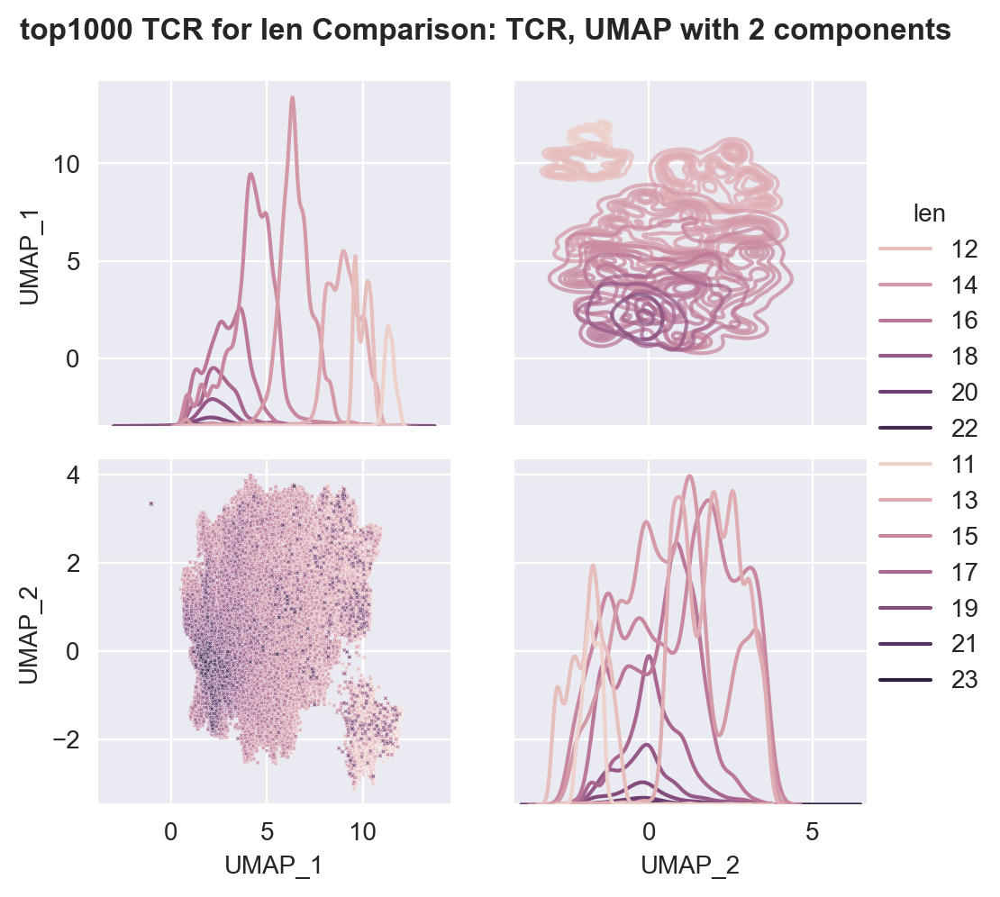

In [84]:
#UMAP
for hue in ['v_family', 'd_family', 'j_family', 'len']:
    plot_reduc(sub.sort_values(hue, ascending=True), hue=hue,
               name=f'top1000 TCR for {hue} Comparison:', reduc='UMAP',
               comp = True, palette = 'gist_ncar')

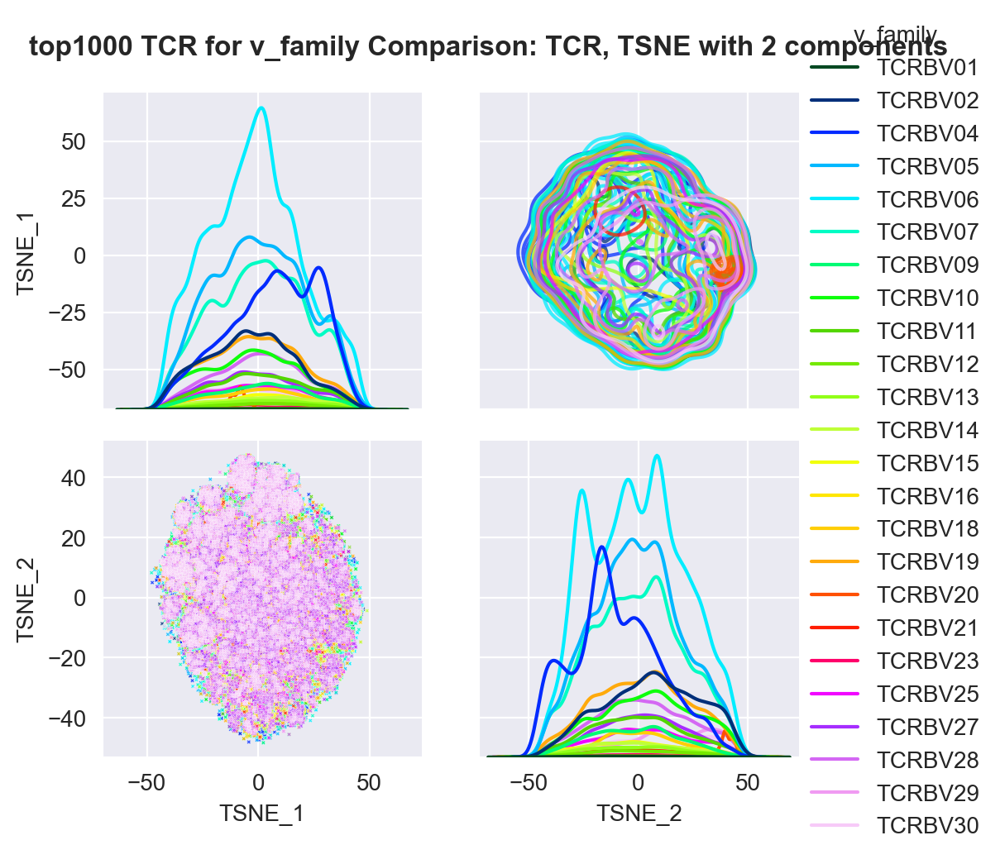

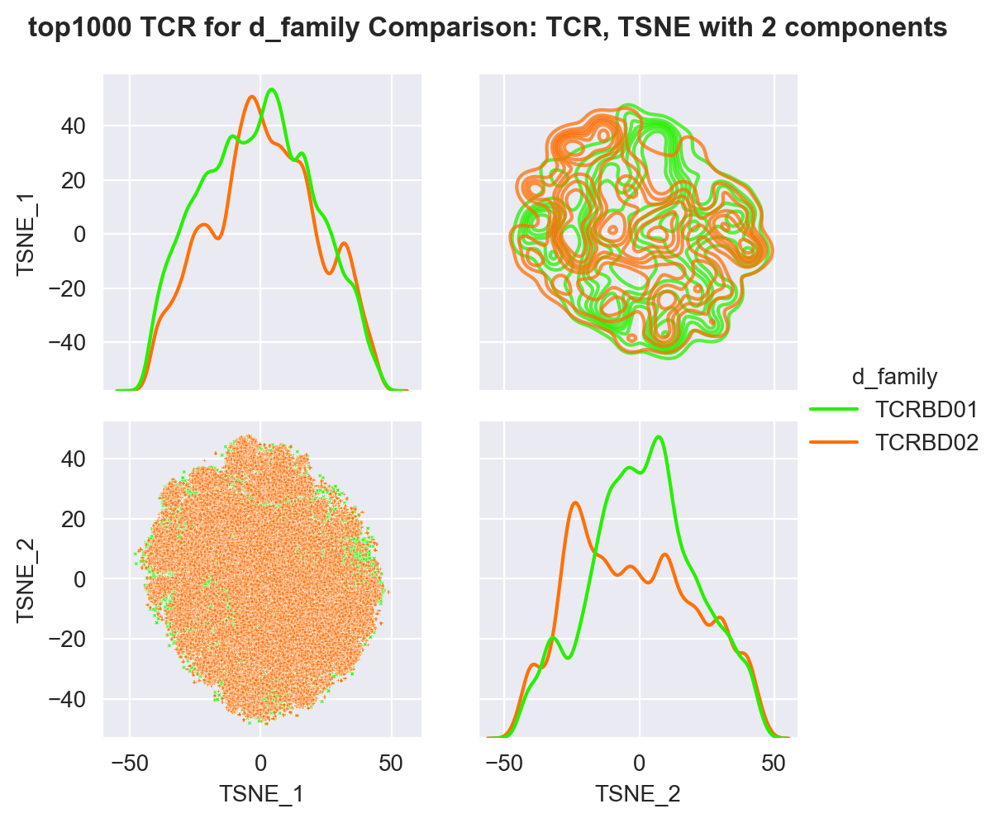

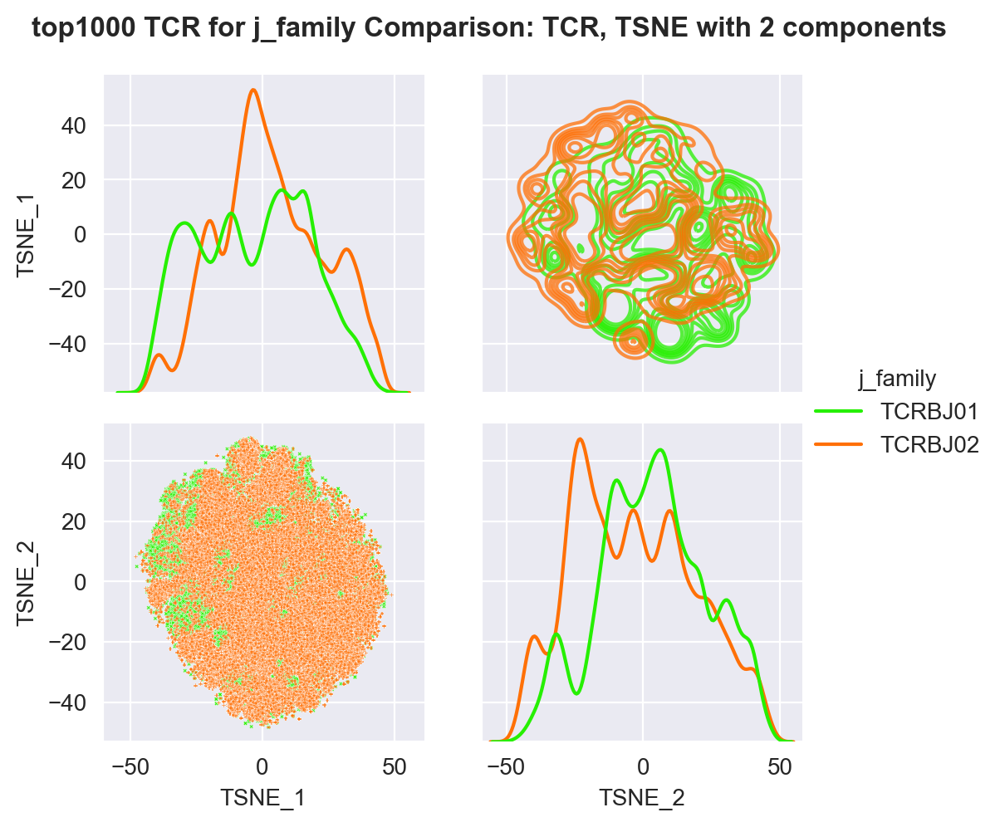

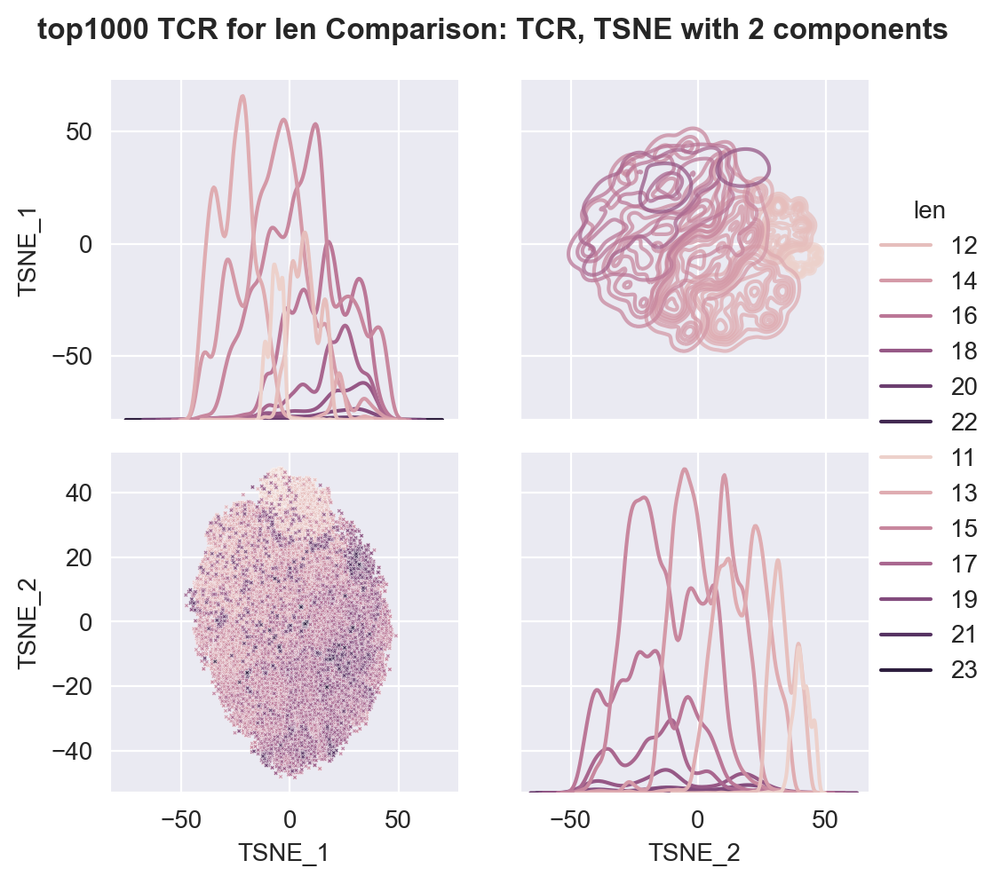

In [85]:
#TSNE
for hue in ['v_family', 'd_family', 'j_family', 'len']:
    plot_reduc(sub.sort_values(hue, ascending=True), hue=hue,
               name=f'top1000 TCR for {hue} Comparison:', reduc='TSNE',
               comp = True, palette = 'gist_ncar')

### Doing same patients but diff CMV 
Getting filenames here

In [86]:
shared_classes = sample_tags.groupby('class').count().sort_values('filename',ascending=False).head(9).index[:7]
fn0 = sample_tags.query('`class` == @shared_classes[0]').filename[0:4].values
fn1 = sample_tags.query('`class` == @shared_classes[1]').filename.values
fn2 = sample_tags.query('`class` == @shared_classes[2]').filename[0:4].values
fn3 = sample_tags.query('`class` == @shared_classes[3]').filename[0:4].values
fn4 = sample_tags.query('`class` == @shared_classes[4]').filename[0:2].values
fn5 = sample_tags.query('`class` == @shared_classes[5]').filename[2:].values
fn6 = sample_tags.query('`class` == @shared_classes[6]').filename[0:2].values

	 Getting the top 4000
	 Onehot-encoding.
	 Embedding 16000 sequences.
	 Fitting TSNE.
	 Waiting on plotting.
	 Getting the top 4000
	 Onehot-encoding.
	 Embedding 24000 sequences.
	 Fitting TSNE.
	 Waiting on plotting.
	 Getting the top 4000
	 Onehot-encoding.
	 Embedding 16000 sequences.
	 Fitting TSNE.
	 Waiting on plotting.
	 Getting the top 4000
	 Onehot-encoding.
	 Embedding 16000 sequences.
	 Fitting TSNE.
	 Waiting on plotting.
	 Getting the top 4000
	 Onehot-encoding.
	 Embedding 8000 sequences.
	 Fitting TSNE.
	 Waiting on plotting.
	 Getting the top 4000
	 Onehot-encoding.
	 Embedding 8000 sequences.
	 Fitting TSNE.
	 Waiting on plotting.
	 Getting the top 4000
	 Onehot-encoding.
	 Embedding 8000 sequences.
	 Fitting TSNE.
	 Waiting on plotting.


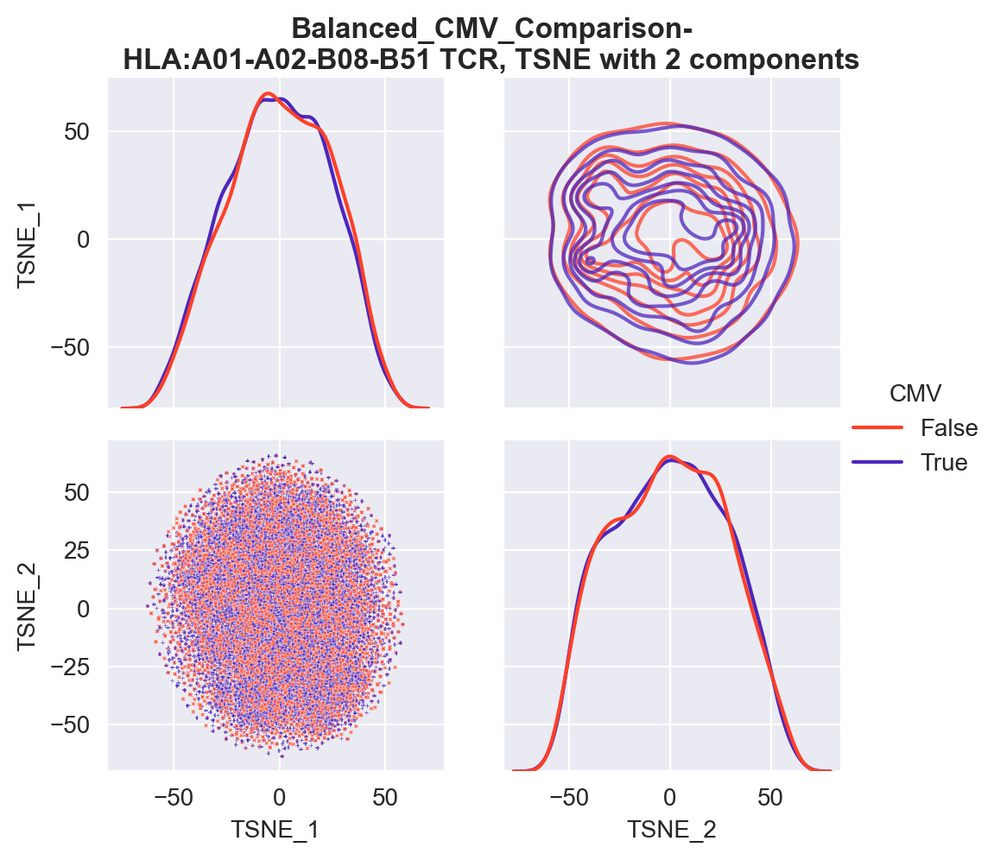

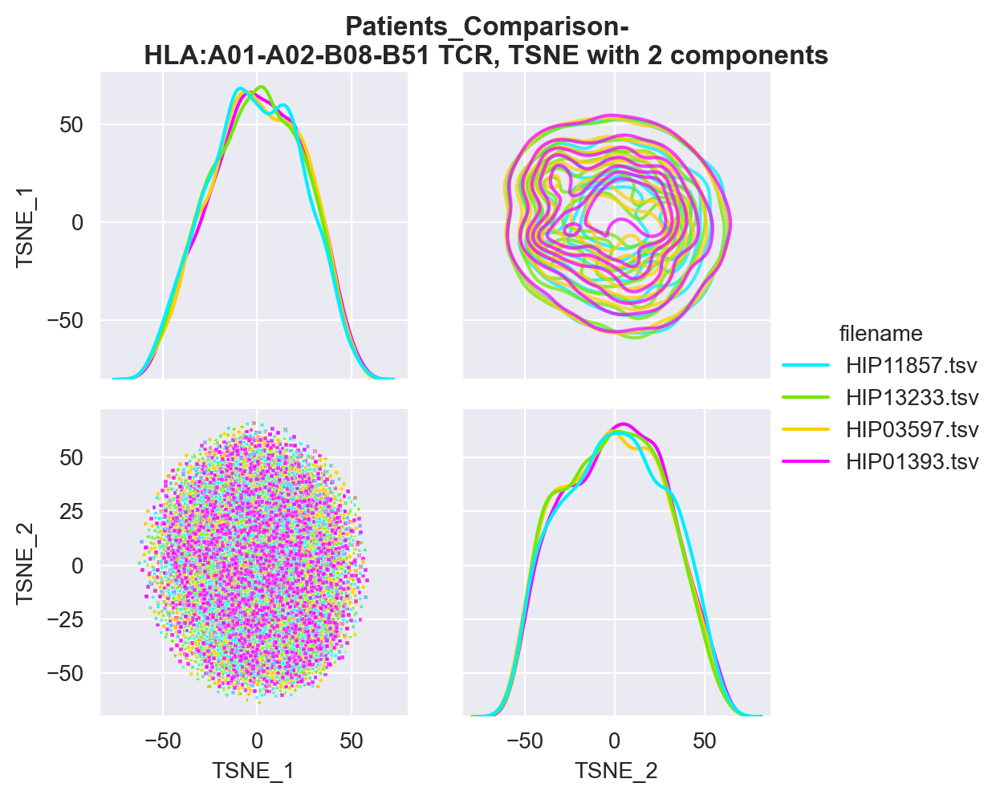

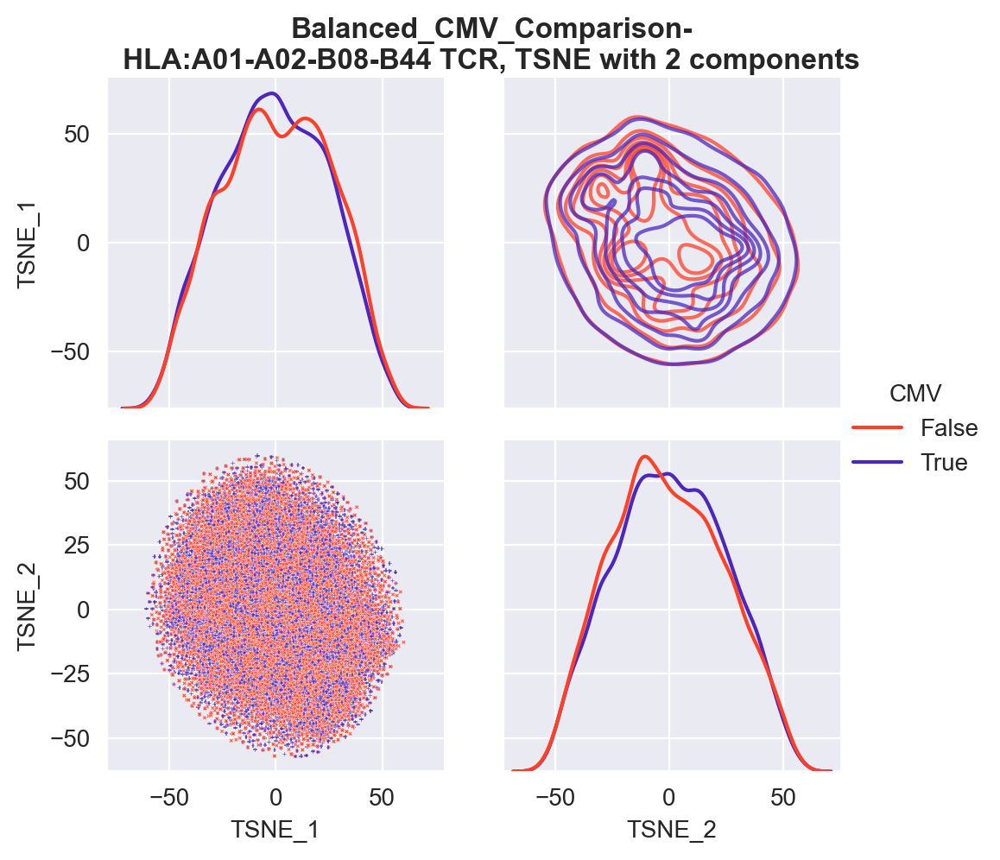

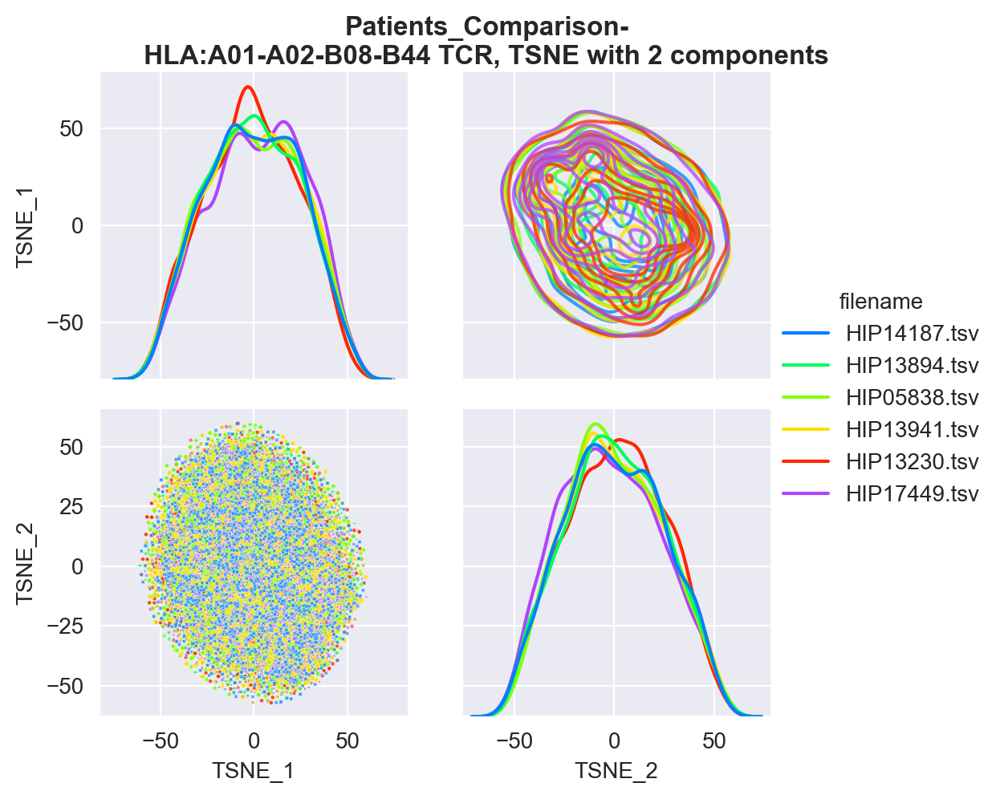

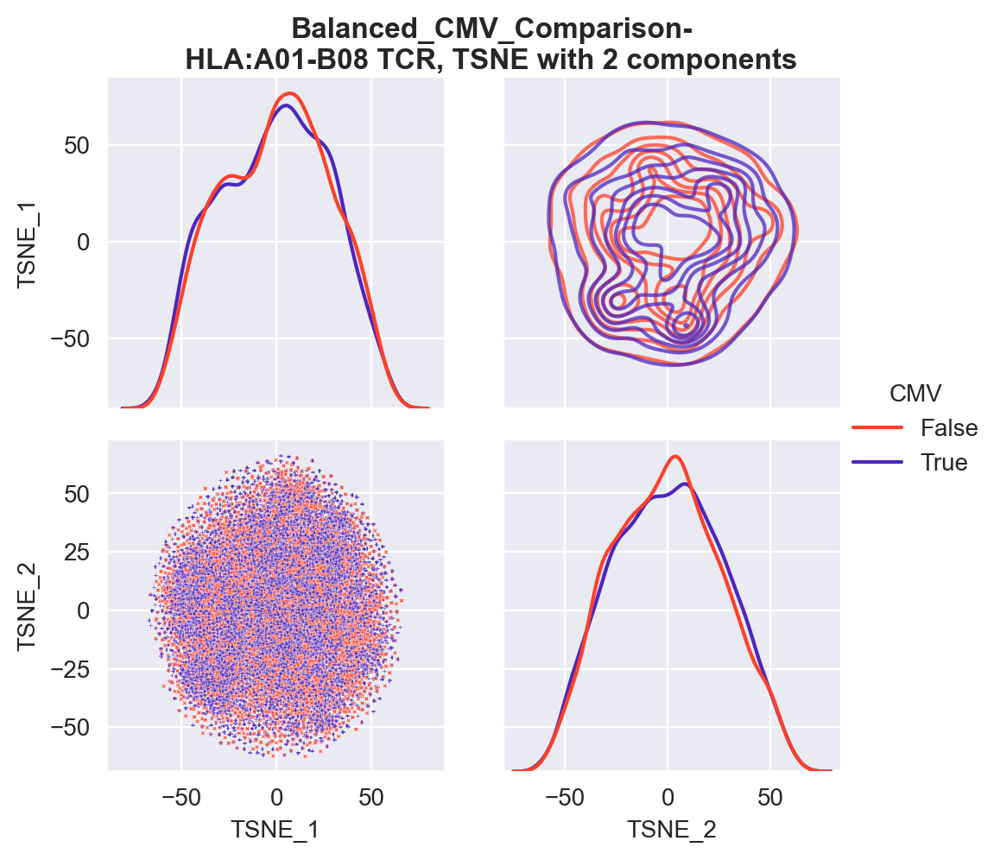

...

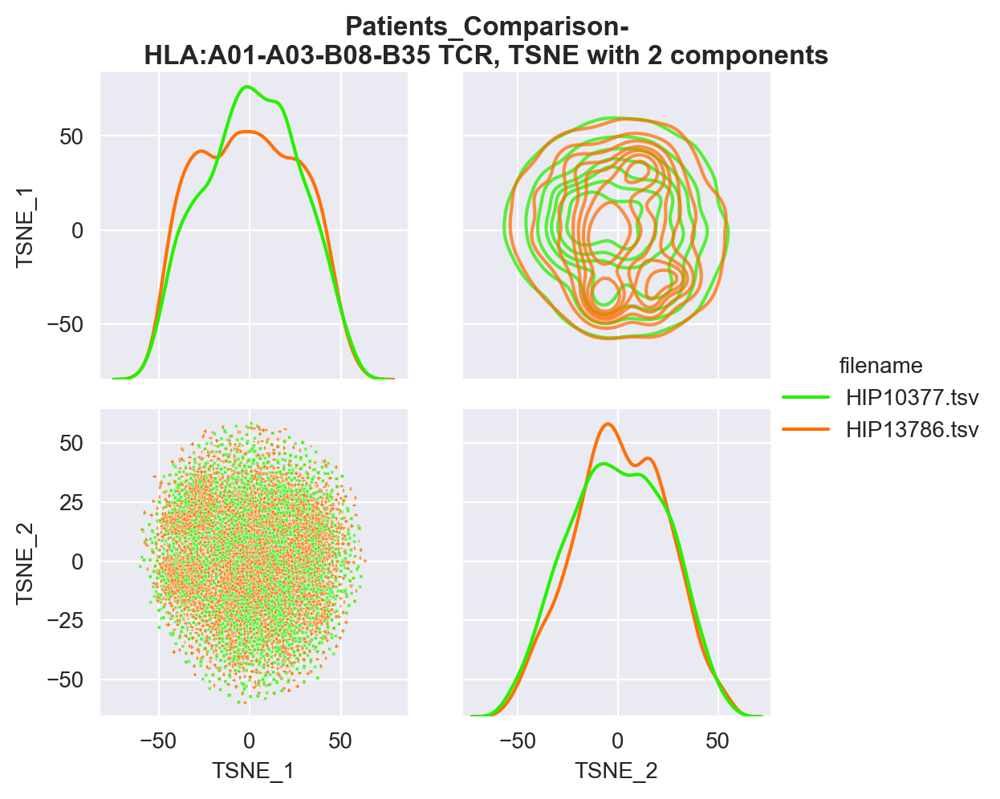

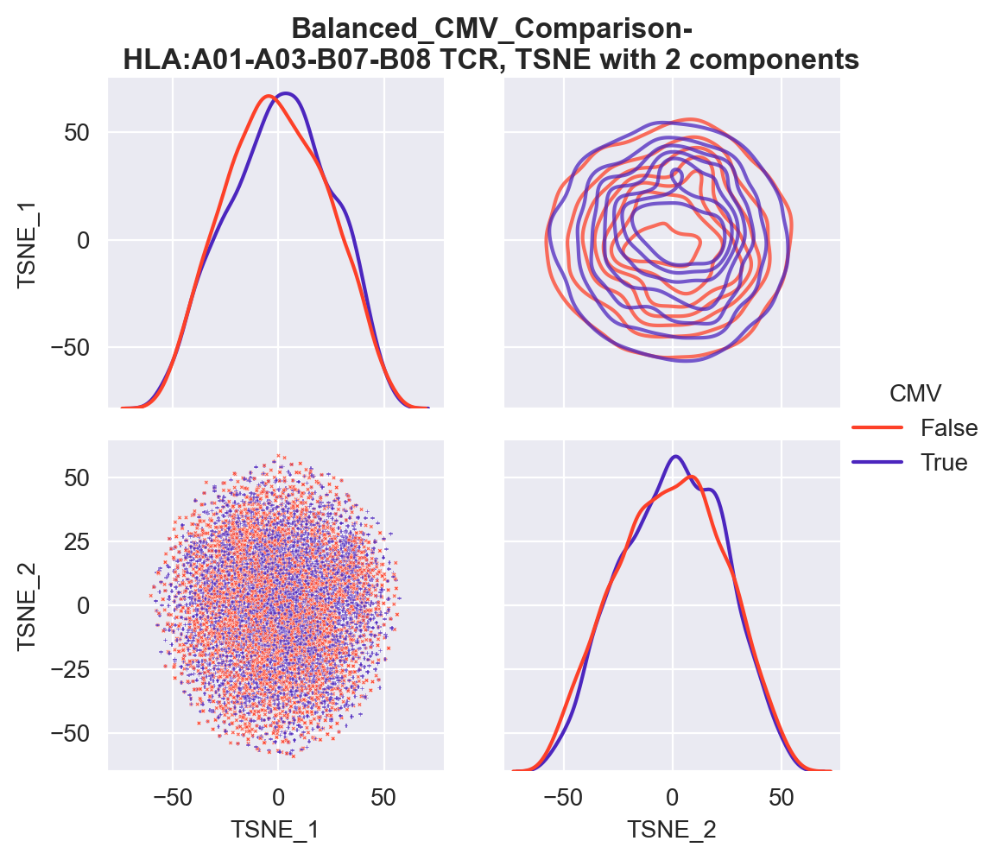

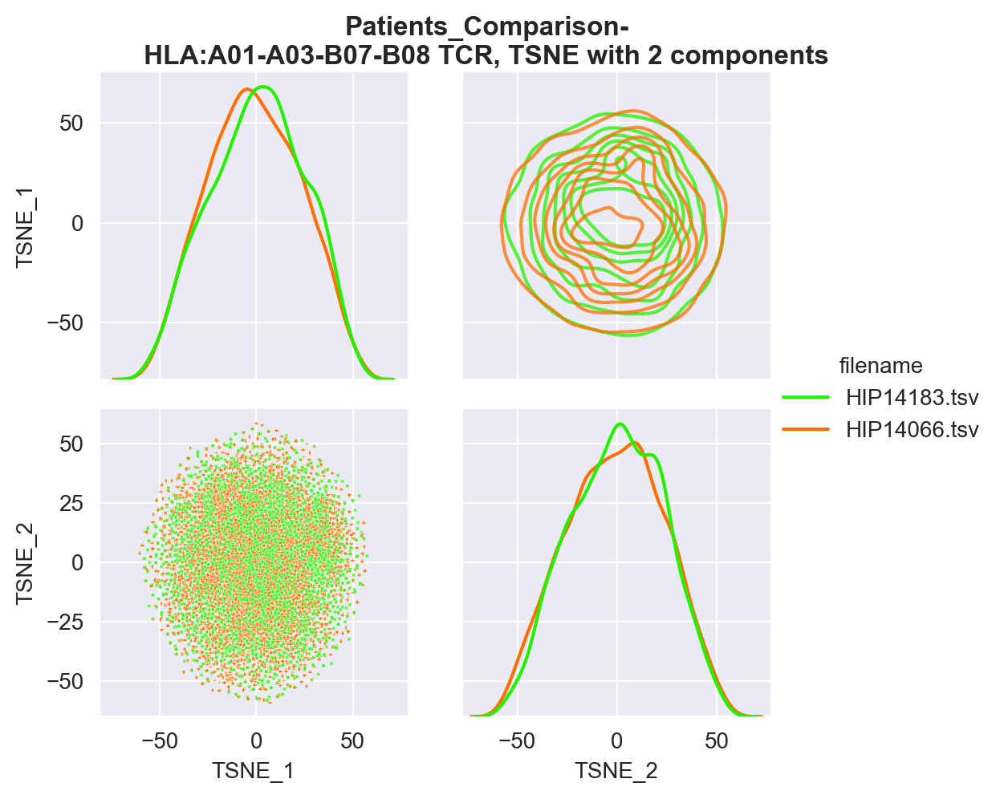

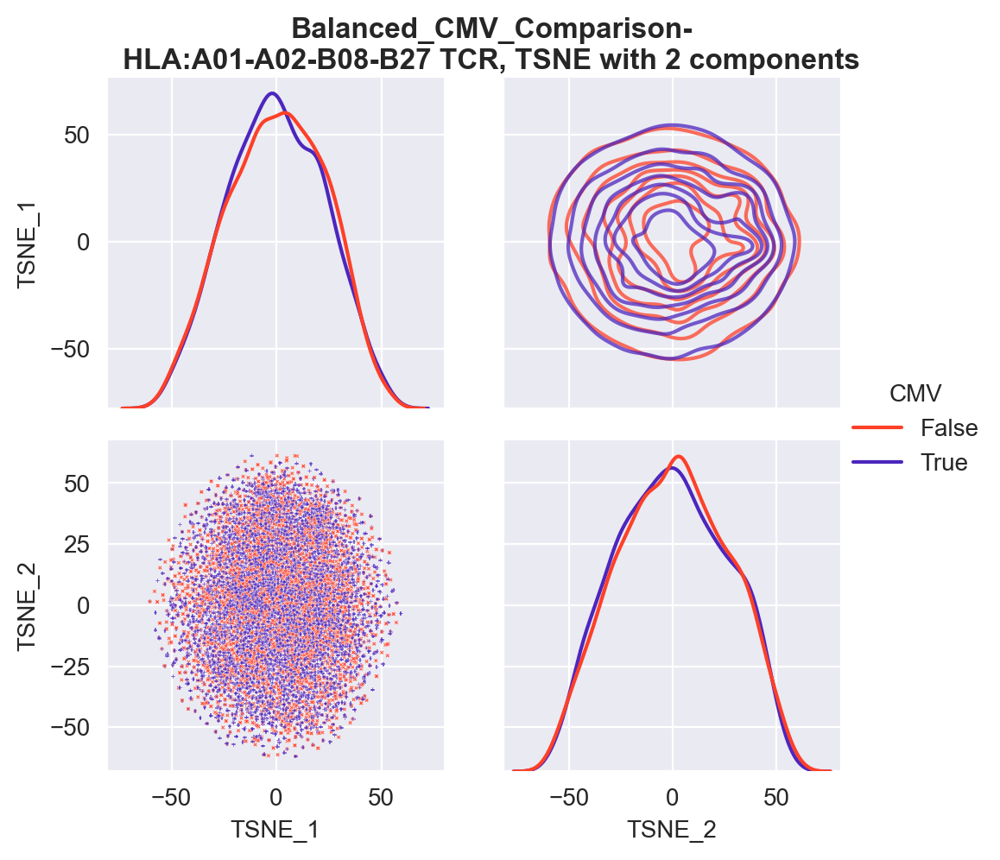

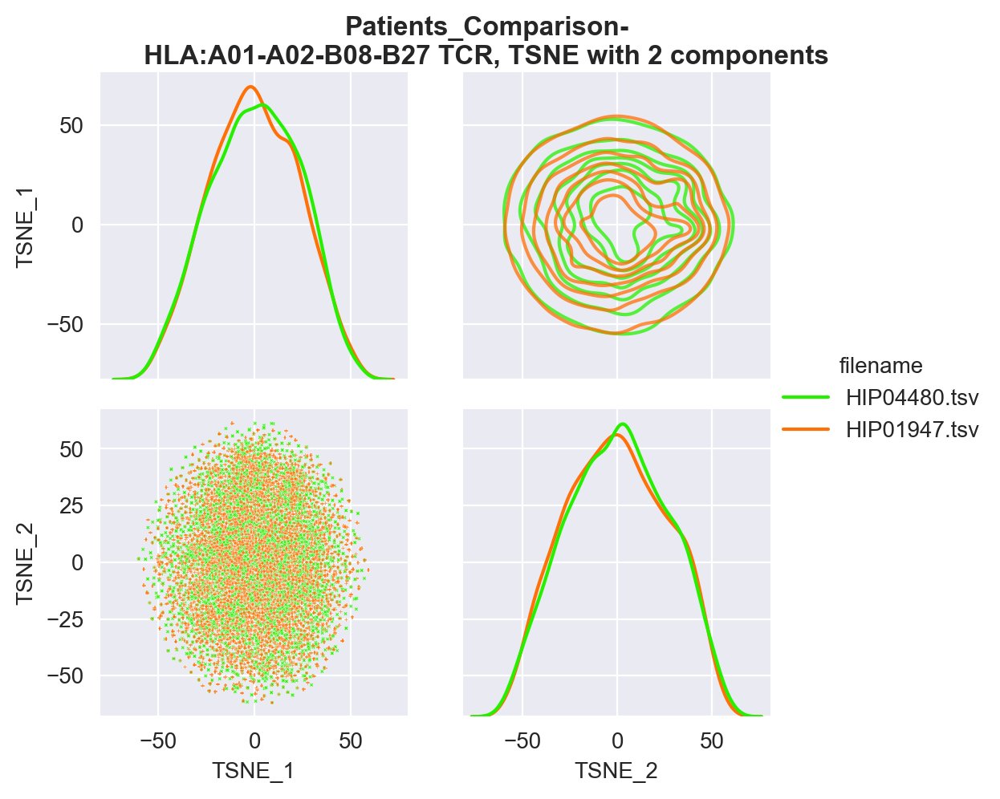

In [88]:
emerson['CMV'] = emerson['true_cmv'].astype(bool)
pal = sns.color_palette('CMRmap_r', n_colors=3)[1], sns.color_palette('CMRmap_r', n_colors=3)[2]
#Shared top10
for c in [fn0, fn1, fn2, fn3, fn4, fn5, fn6]:
    #fns = sample_tags.query('`class`== @c').filename.unique()
    class_ = sample_tags.query('filename in @c')['class'].unique()[0]    
    sub = get_topk(emerson.query('filename in @c and len>10 and len <=23'), 4000,
                   verbose = False)
    tmp = get_reduc(sub, vae, reduc='TSNE',positional = True)
    plot_reduc(tmp, hue='CMV',reduc='TSNE', 
               name='Balanced_CMV_Comparison-\nHLA:'+str(class_), 
              comp = True, palette = pal)
    plt.savefig('./VAE/comp_'+str(class_)+'_CMV.jpg', dpi = 300)
    
    plot_reduc(tmp, hue='filename', reduc='TSNE',
               name='Patients_Comparison-\nHLA:'+str(class_), 
              comp = True, palette = 'gist_ncar')
    plt.savefig('./VAE/comp_'+str(class_)+'_Patients.jpg', dpi = 300)

	 Getting the top 4000
	 Onehot-encoding.
	 Embedding 16000 sequences.
	 Fitting UMAP.
	 Waiting on plotting.
	 Getting the top 4000
	 Onehot-encoding.
	 Embedding 24000 sequences.
	 Fitting UMAP.
	 Waiting on plotting.
	 Getting the top 4000
	 Onehot-encoding.
	 Embedding 16000 sequences.
	 Fitting UMAP.
	 Waiting on plotting.
	 Getting the top 4000
	 Onehot-encoding.
	 Embedding 16000 sequences.
	 Fitting UMAP.
	 Waiting on plotting.
	 Getting the top 4000
	 Onehot-encoding.
	 Embedding 8000 sequences.
	 Fitting UMAP.
	 Waiting on plotting.
	 Getting the top 4000
	 Onehot-encoding.
	 Embedding 8000 sequences.
	 Fitting UMAP.
	 Waiting on plotting.
	 Getting the top 4000
	 Onehot-encoding.
	 Embedding 8000 sequences.
	 Fitting UMAP.
	 Waiting on plotting.


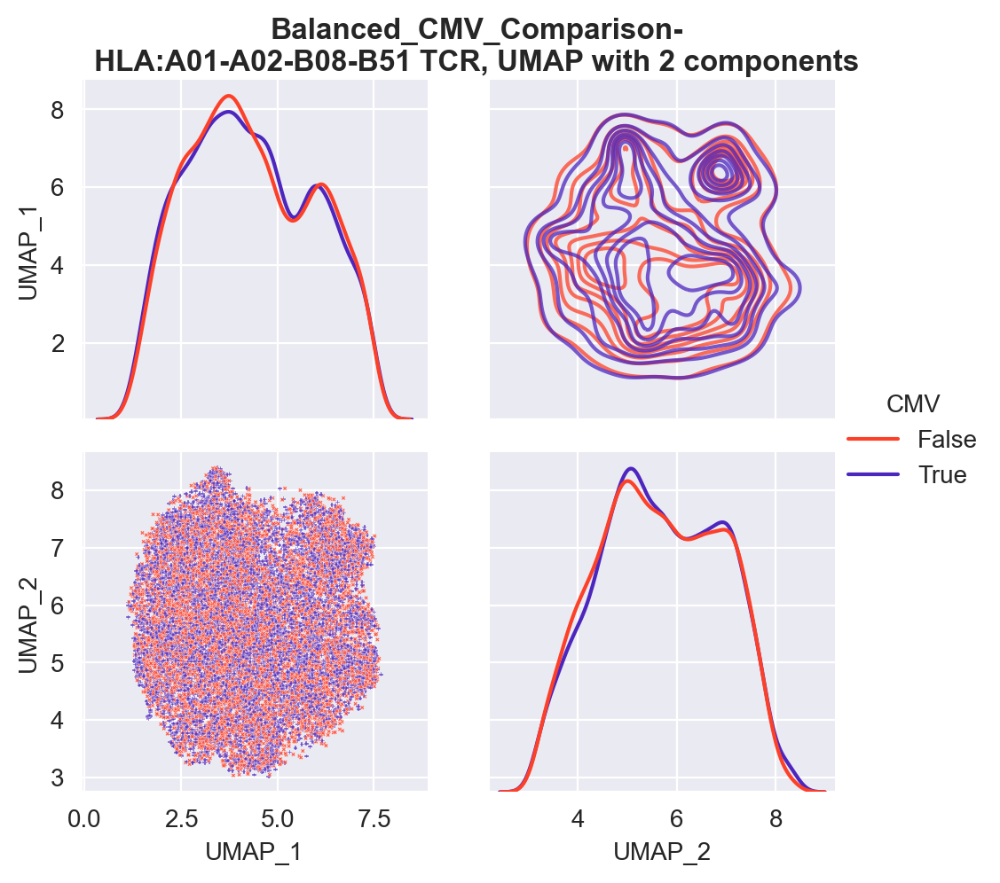

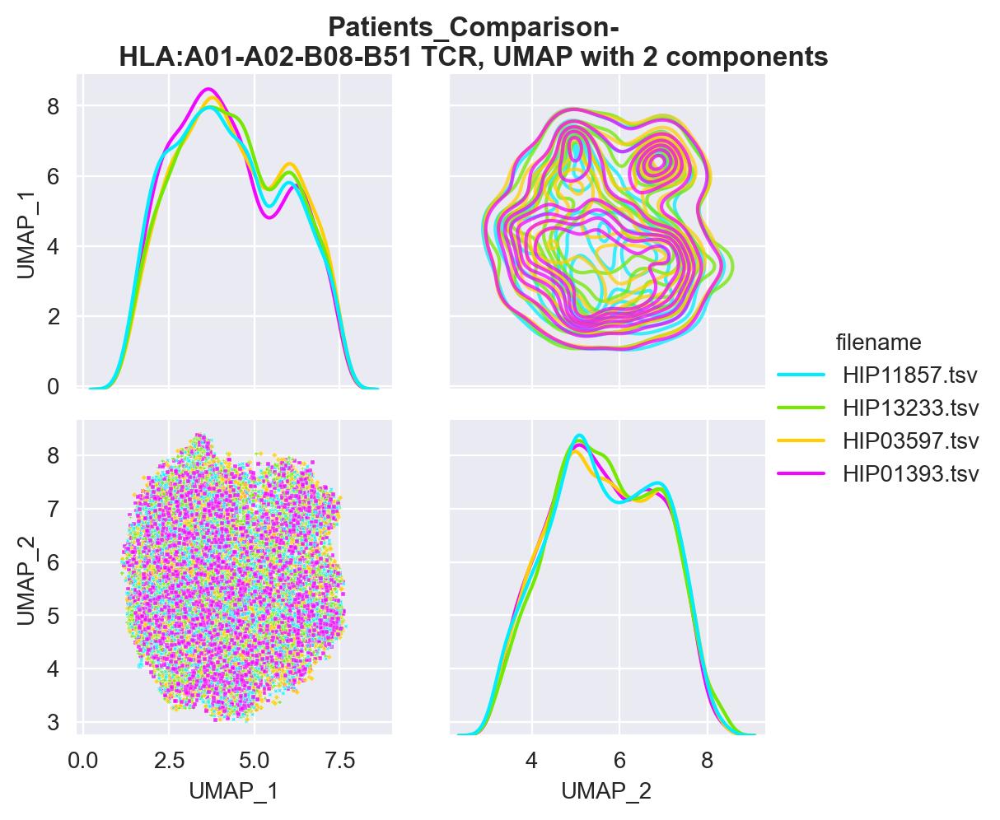

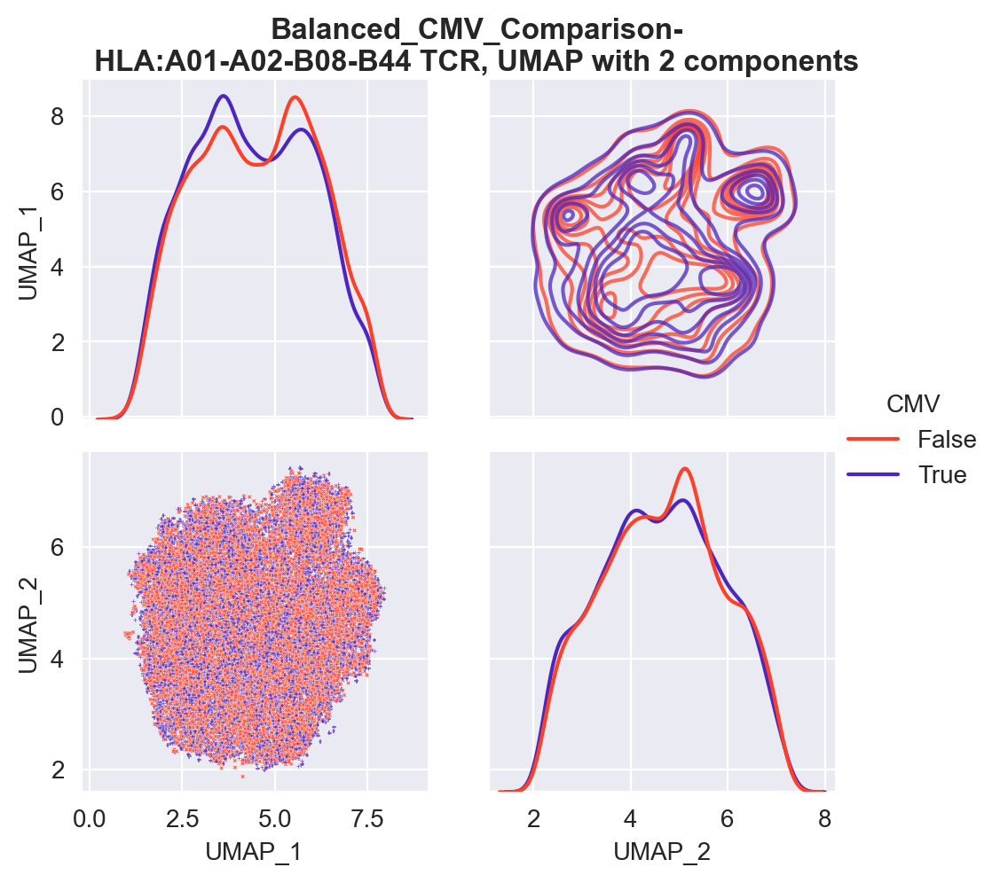

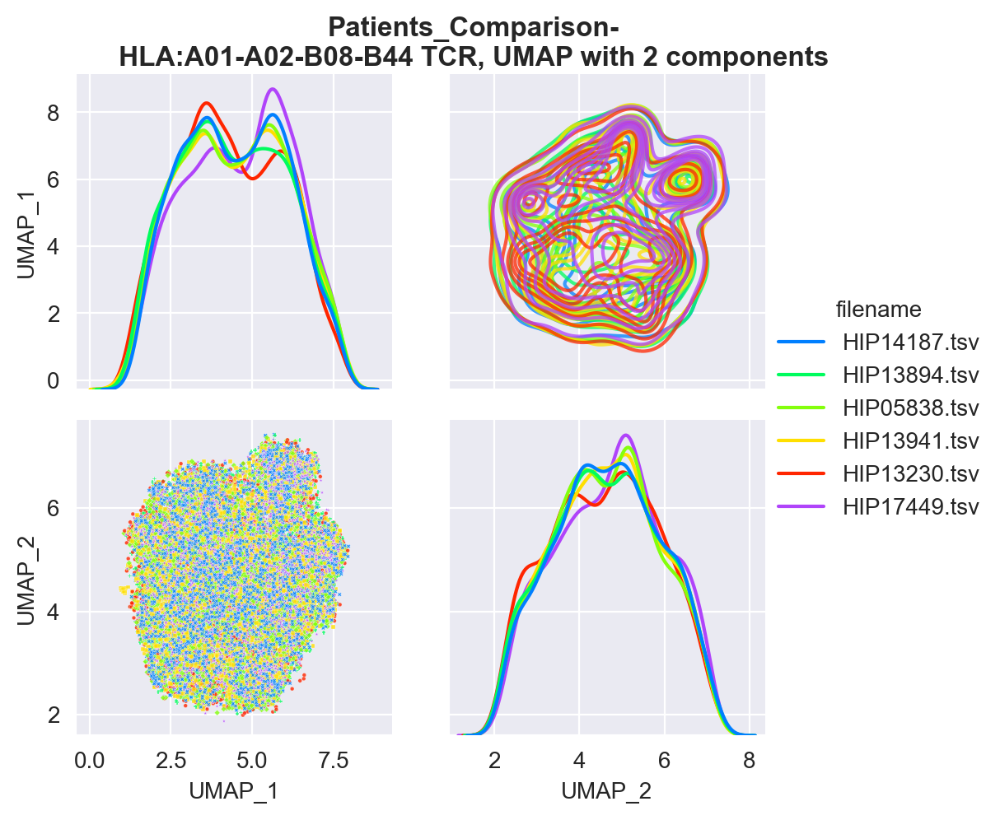

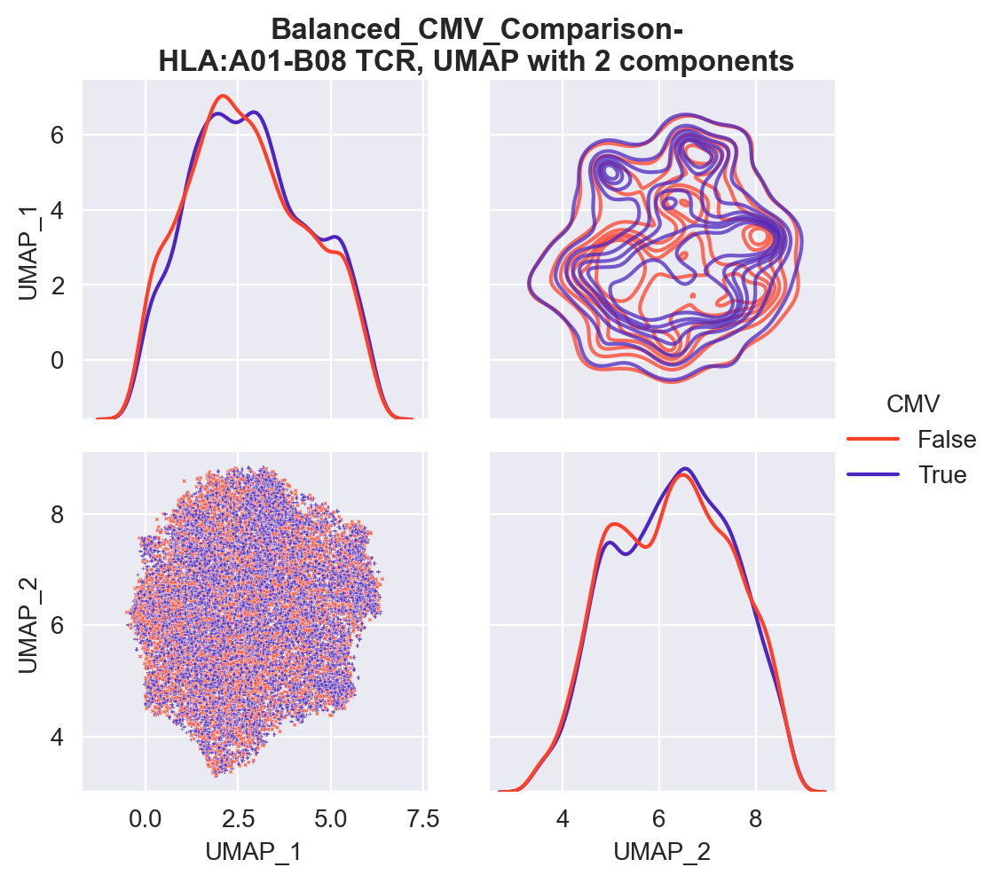

...

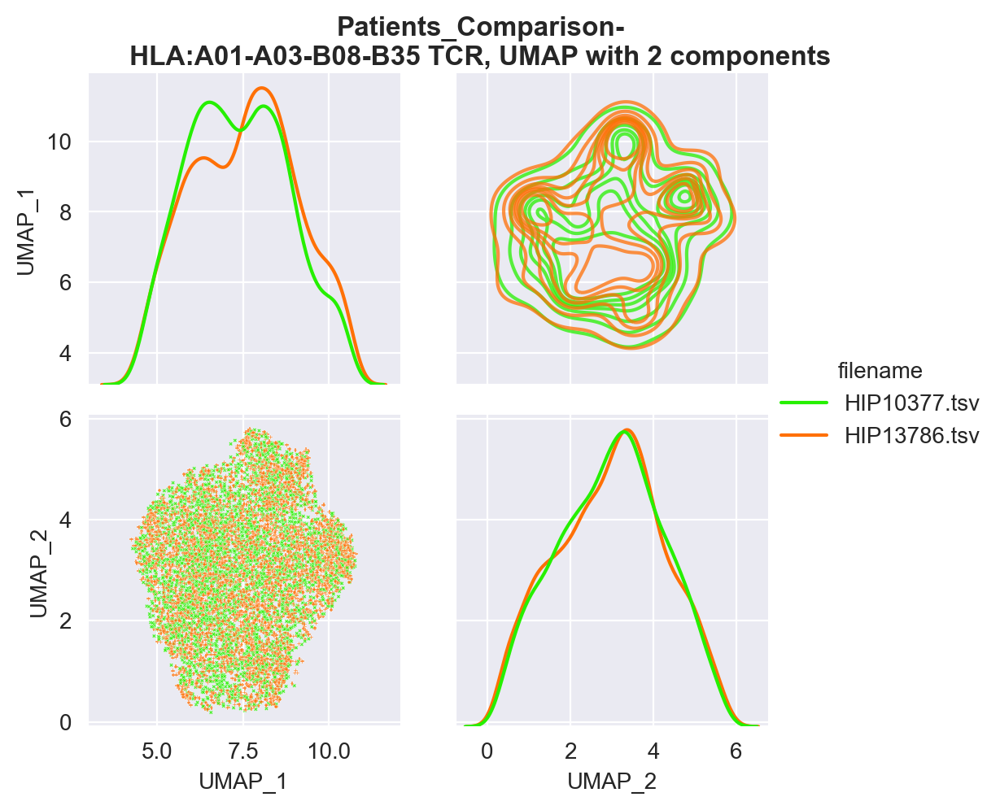

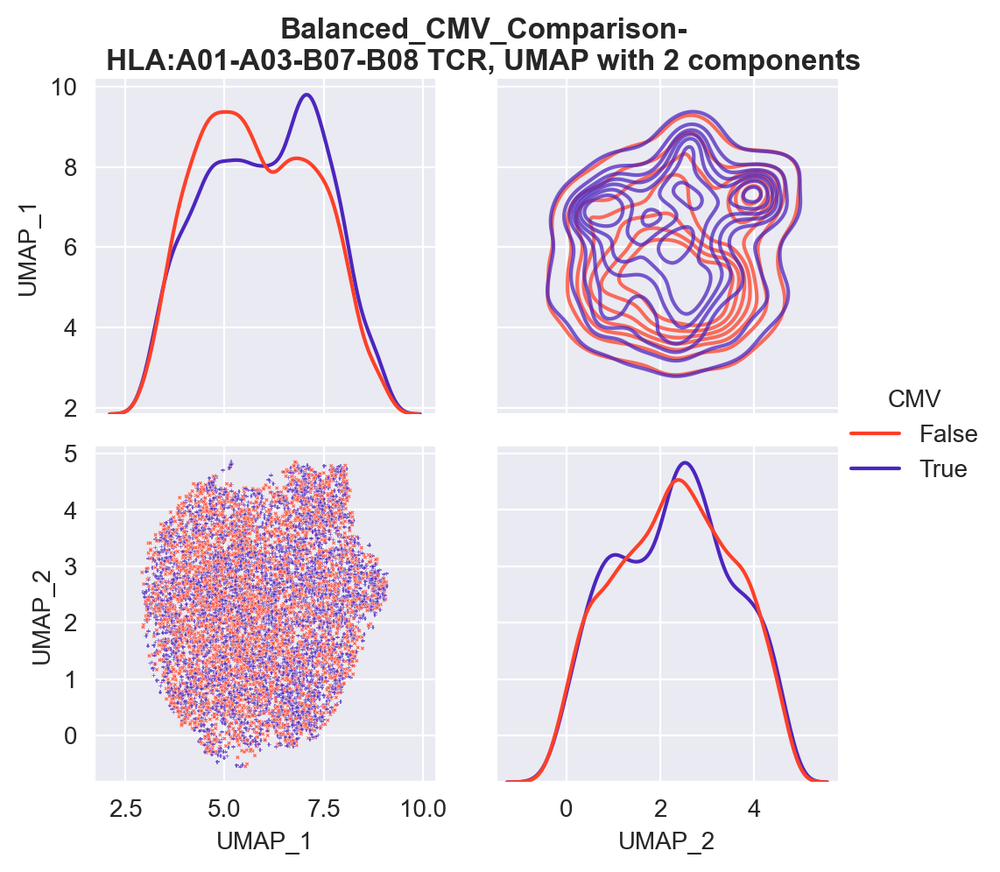

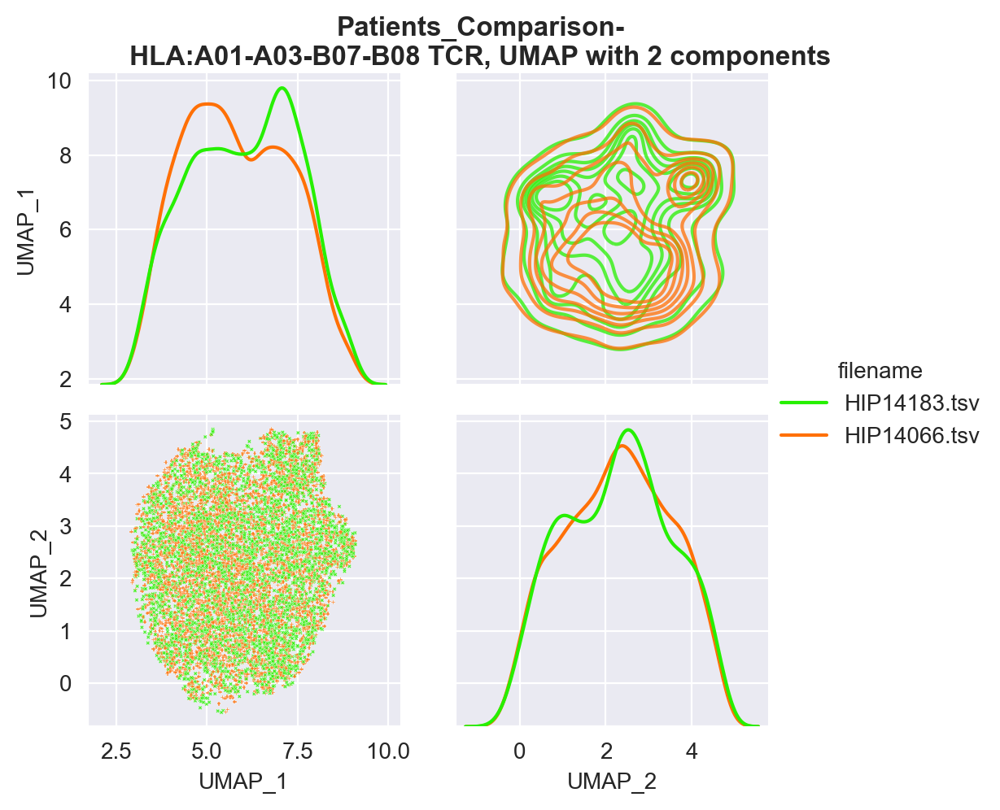

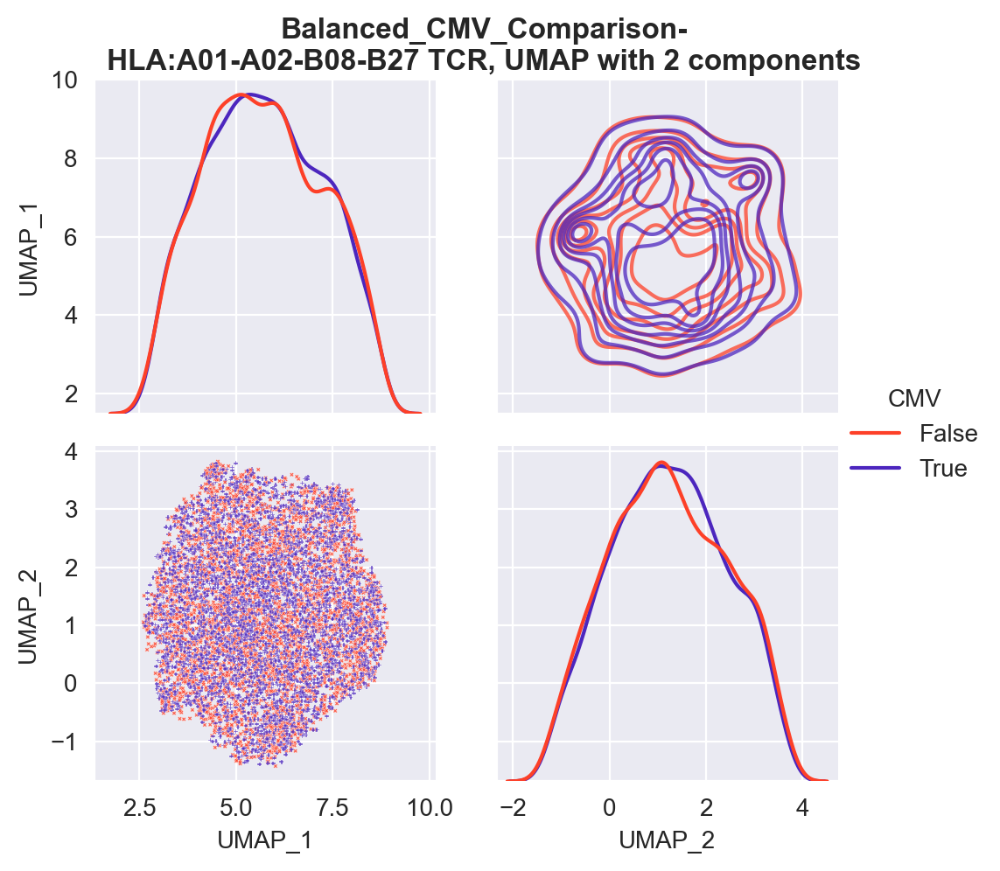

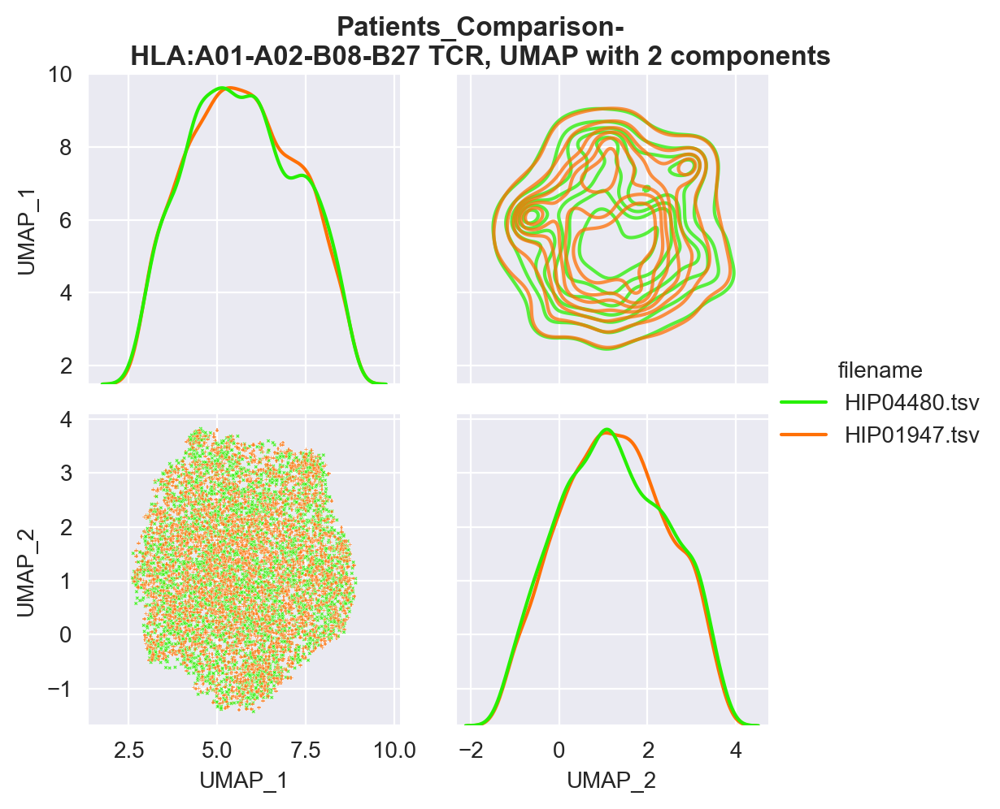

In [90]:
emerson['CMV'] = emerson['true_cmv'].astype(bool)
pal = sns.color_palette('CMRmap_r', n_colors=3)[1], sns.color_palette('CMRmap_r', n_colors=3)[2]
#Shared top10
for c in [fn0, fn1, fn2, fn3, fn4, fn5, fn6]:
    #fns = sample_tags.query('`class`== @c').filename.unique()
    class_ = sample_tags.query('filename in @c')['class'].unique()[0]    
    sub = get_topk(emerson.query('filename in @c and len>10 and len <=23'), 4000,
                   verbose = False)
    tmp = get_reduc(sub, vae, reduc='UMAP',positional = True)
    plot_reduc(tmp, hue='CMV',reduc='UMAP', 
               name='Balanced_CMV_Comparison-\nHLA:'+str(class_), 
              comp = True, palette = pal)
    plt.savefig('./VAE/comp_UMAP'+str(class_)+'_CMV.jpg', dpi = 300)
    
    plot_reduc(tmp, hue='filename', reduc='UMAP',
               name='Patients_Comparison-\nHLA:'+str(class_), 
              comp = True, palette = 'gist_ncar')
    plt.savefig('./VAE/comp_UMAP'+str(class_)+'_Patients.jpg', dpi = 300)

In [97]:
#fn=['HIP16867.tsv', 'HIP05665.tsv']
#SAME HLA; diff CMV
fn = ['HIP01947.tsv', 'HIP04480.tsv']
#topk = get_topk(emerson.query('filename in @fn'),30000)[0].query('len>10 and len<=23')
ump = get_reduc(emerson.query('filename in @fn and len > 10 and len <= 23'), vae, reduc = 'UMAP')
tsn = get_reduc(emerson.query('filename in @fn and len > 10 and len <= 23'), vae, reduc = 'TSNE')

	 Onehot-encoding.
	 Embedding 79592 sequences.
	 Fitting UMAP.
	 Waiting on plotting.
	 Onehot-encoding.
	 Embedding 79592 sequences.
	 Fitting TSNE.
	 Waiting on plotting.


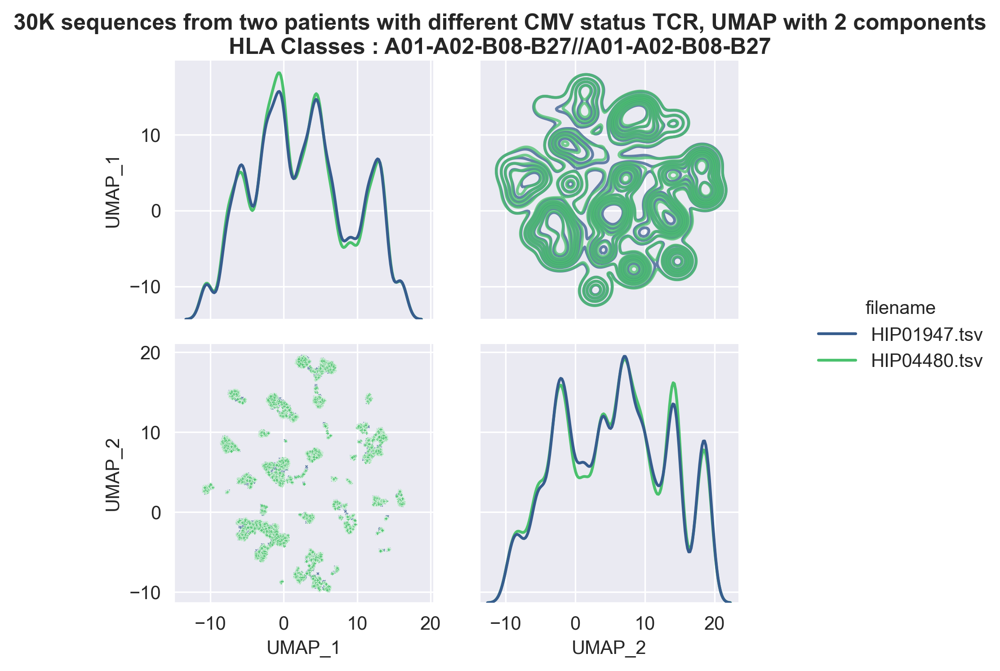

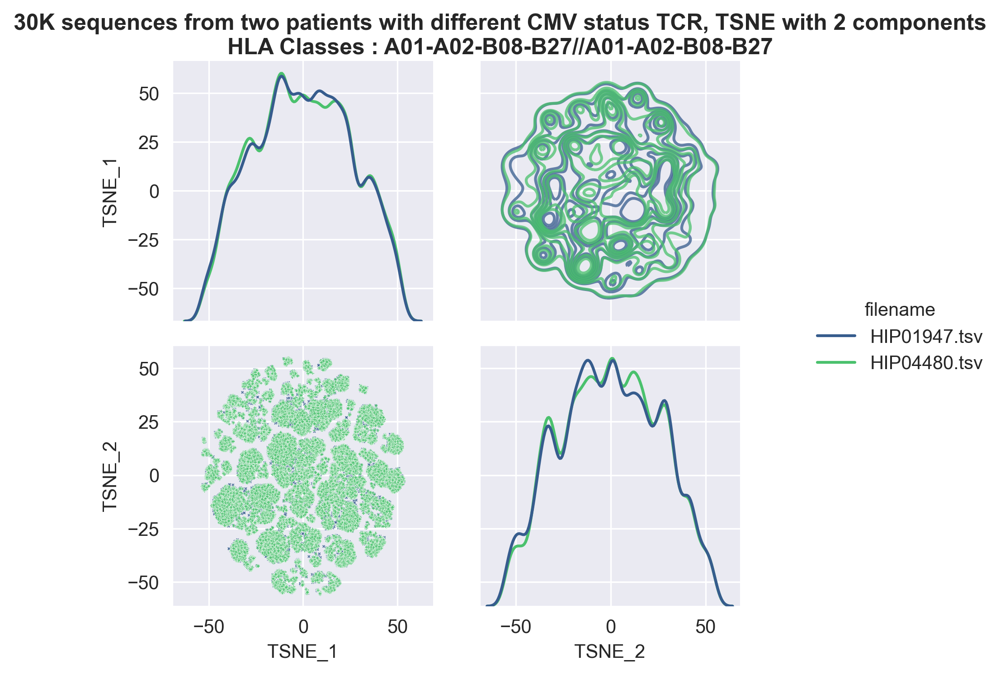

In [99]:
pal = [sns.color_palette('viridis_r',n_colors=6)[-2], sns.color_palette('viridis_r',n_colors=6)[1]]
plot_reduc(ump, hue='filename', reduc = 'UMAP', palette = pal,
          name = '30K sequences from two patients with different CMV status')
plot_reduc(tsn, hue='filename', reduc = 'TSNE', palette = pal,
          name = '30K sequences from two patients with different CMV status')

### Masking

In [132]:
#Redoing a single TSNE for all to make it deterministic
fns = ['HIP13992.tsv', 'HIP13986.tsv']
sub1, shared = get_topk(mask_seq(emerson.query('filename in @fns')), 5000) #Masking V/J

sub2 = sub1.copy().drop(columns='amino_acid').rename(columns = {'masked_vj':'amino_acid'})
sub2['masked'] = 'VJ'
sub3 = sub1.copy().drop(columns='amino_acid').rename(columns = {'masked_centre':'amino_acid'})
sub3['masked'] = 'centre'
sub1['masked'] = 'none'
df = pd.concat([sub1,sub2,sub3], ignore_index=True).drop(columns=['masked_vj','masked_centre']).query('len > 10 and len <=23')
df = get_reduc(df, model_reload, reduc='TSNE')
df = get_reduc(df, model_reload, reduc='UMAP')

	 Getting the top 5000
# Shared in top 5000 seqs : 31
	 Onehot-encoding.
	 Embedding 29907 sequences.
	 Fitting TSNE.
	 Waiting on plotting.
	 Onehot-encoding.
	 Embedding 29907 sequences.
	 Fitting UMAP.
	 Waiting on plotting.


In [ ]:
for reduc in ['TSNE','UMAP']:
    for masked in df.masked.unique():
        for hue, pal in zip(['filename','v_family'],['seismic_r','hsv']):
            plot_reduc(df.query('masked==@masked'), hue = hue, 
                       reduc = reduc,
                       name = f'{reduc} of TCR_sequences with {masked} part masked',
                       palette = pal)
            plt.savefig(f'../../../meetings/presentation_results/210322_update/mask/top_5k_{reduc}_{masked}_{hue}.jpg', dpi = 300)

In [161]:
def mask_pipeline(fns, topk):
    #Redoing a single TSNE for all to make it deterministic
    sub1, shared = get_topk(mask_seq(emerson.query('filename in @fns')), topk) #Masking V/J
    
    sub2 = sub1.copy().drop(columns='amino_acid').rename(columns = {'masked_vj':'amino_acid'})
    sub2['masked'] = 'VJ'
    sub3 = sub1.copy().drop(columns='amino_acid').rename(columns = {'masked_centre':'amino_acid'})
    sub3['masked'] = 'centre'
    sub1['masked'] = 'none'
    df = pd.concat([sub1,sub2,sub3], ignore_index=True).drop(columns=['masked_vj','masked_centre']).query('len > 10 and len <=23')
    df = get_reduc(df, model_reload, reduc='TSNE')
    #df = get_reduc(df, model_reload, reduc='UMAP')
    return df

In [163]:
same_HLA = mask_pipeline(fxs, 2000)

	 Getting the top 2500
# Shared in top 2500 seqs : 8
	 Onehot-encoding.
	 Embedding 44784 sequences.
	 Fitting TSNE.
	 Waiting on plotting.


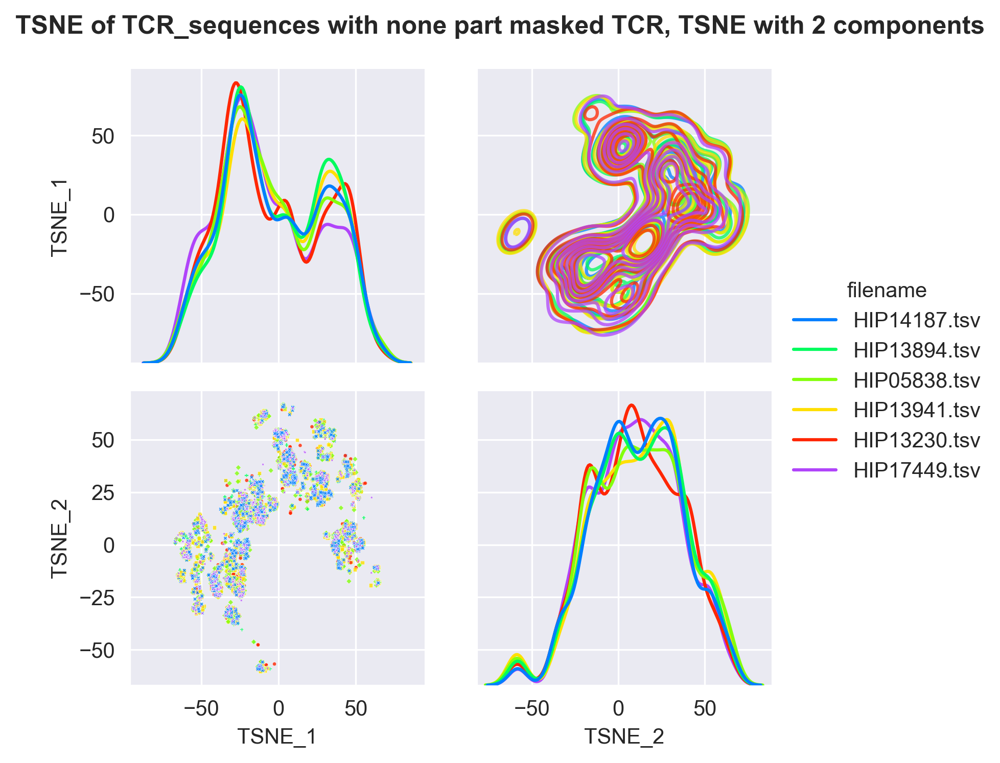

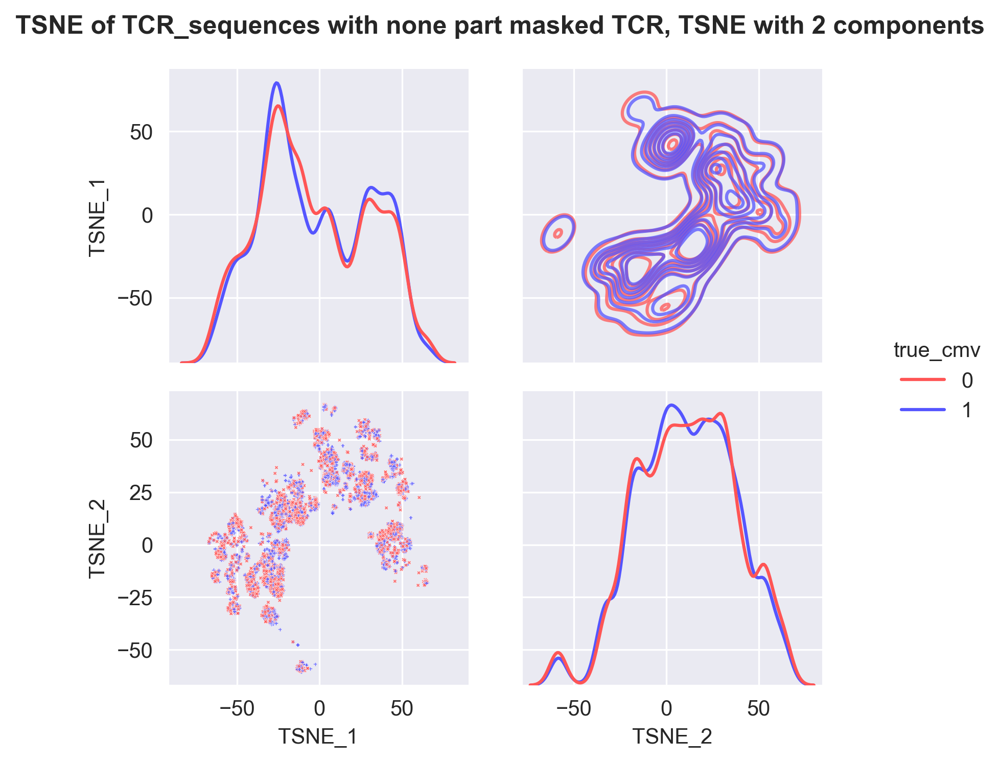

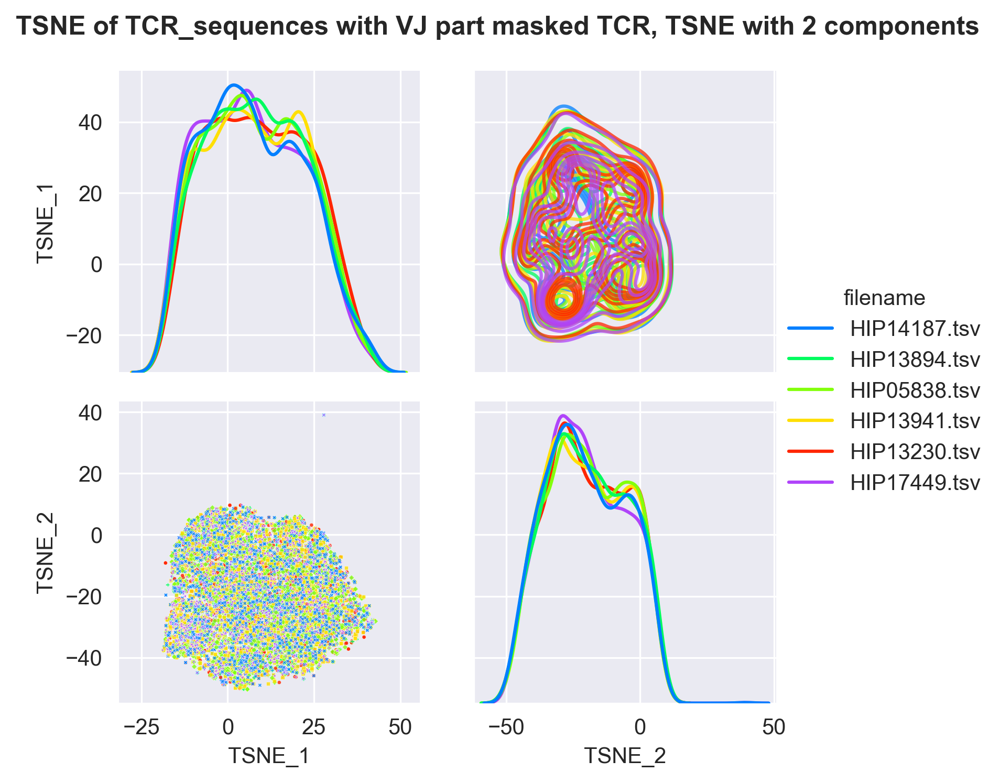

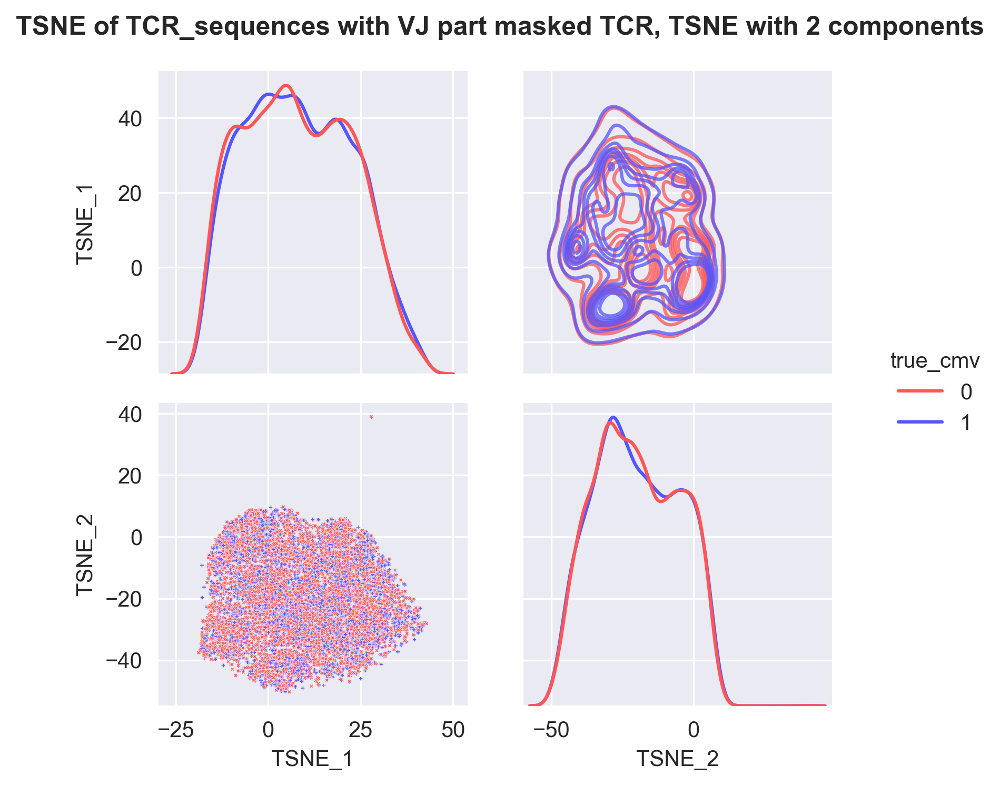

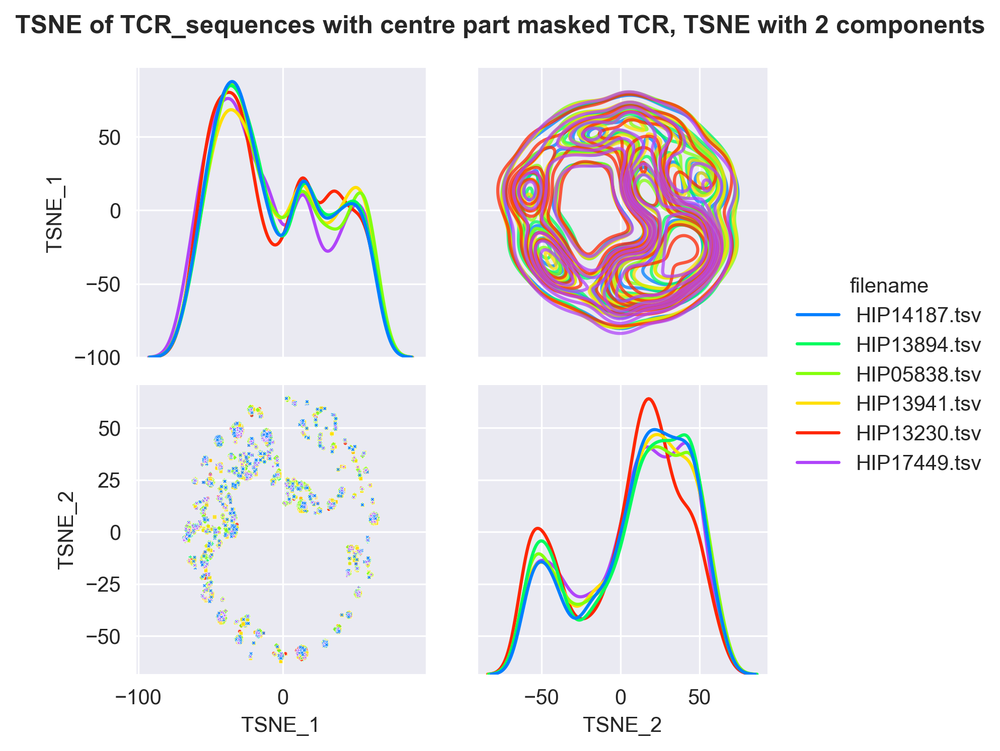

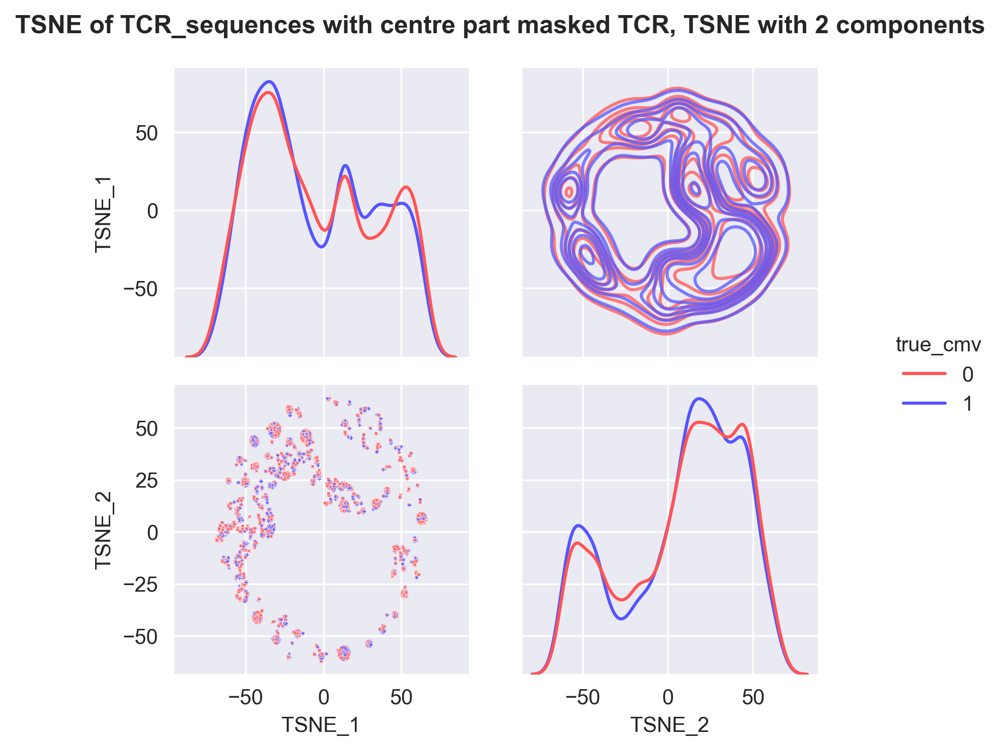

In [164]:
for reduc in ['TSNE']:
    for masked in same_HLA.masked.unique():
        for hue, pal in zip(['filename','true_cmv'],['gist_ncar','seismic_r']):
            plot_reduc(same_HLA.query('masked==@masked'), hue = hue, 
                       reduc = reduc,
                       name = f'{reduc} of TCR_sequences with {masked} part masked',
                       palette = pal)
            plt.savefig(f'../../../meetings/presentation_results/210322_update/mask/same_HLA/cmv_top_5k_{reduc}_{masked}_{hue}.jpg', dpi = 300)

	 Getting the top 3000
# Shared in top 3000 seqs : 7
	 Onehot-encoding.
	 Embedding 6000 sequences.
	 Fitting TSNE.
	 Waiting on plotting.


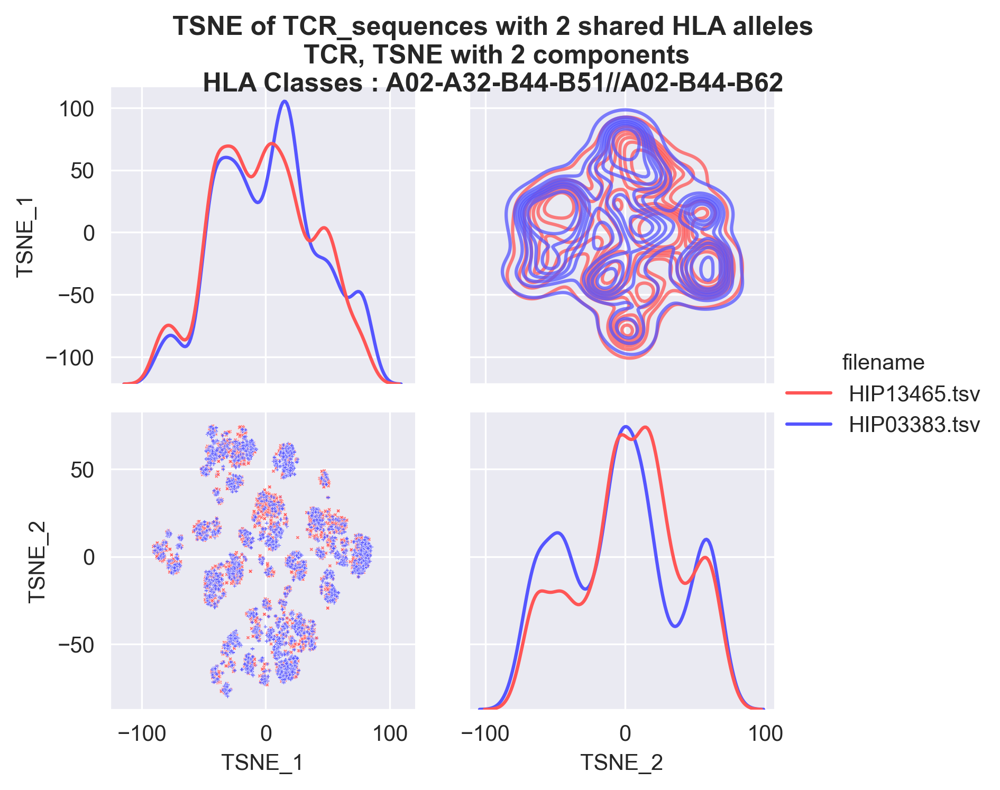

In [184]:
fns = ['HIP13465.tsv', 'HIP03383.tsv']
tmp = get_reduc(get_topk(emerson.query('filename in @fns and len>10 and len <=23'), 3000)[0], model_reload, reduc = 'TSNE')
masked = 'none'
plot_reduc(tmp, hue = 'filename', 
           reduc = 'TSNE',
           name = f'{reduc} of TCR_sequences with 2 shared HLA alleles\n',
           palette = 'seismic_r', comp=False)
plt.savefig(f'../../../meetings/presentation_results/210322_update/cmv_top_3k_{reduc}_{masked}_{hue}.jpg', dpi = 300)

In [179]:
fns = ['HIP09159.tsv', 'HIP14202.tsv']
#fns = ['HIP13465.tsv', 'HIP03383.tsv']
tmp = get_reduc(get_topk(emerson.query('filename in @fns and len>10 and len <=23'), 3000)[0], model_reload, reduc = 'TSNE')
masked = 'none'

	 Getting the top 3000
# Shared in top 3000 seqs : 10
	 Onehot-encoding.
	 Embedding 6000 sequences.
	 Fitting TSNE.
	 Waiting on plotting.


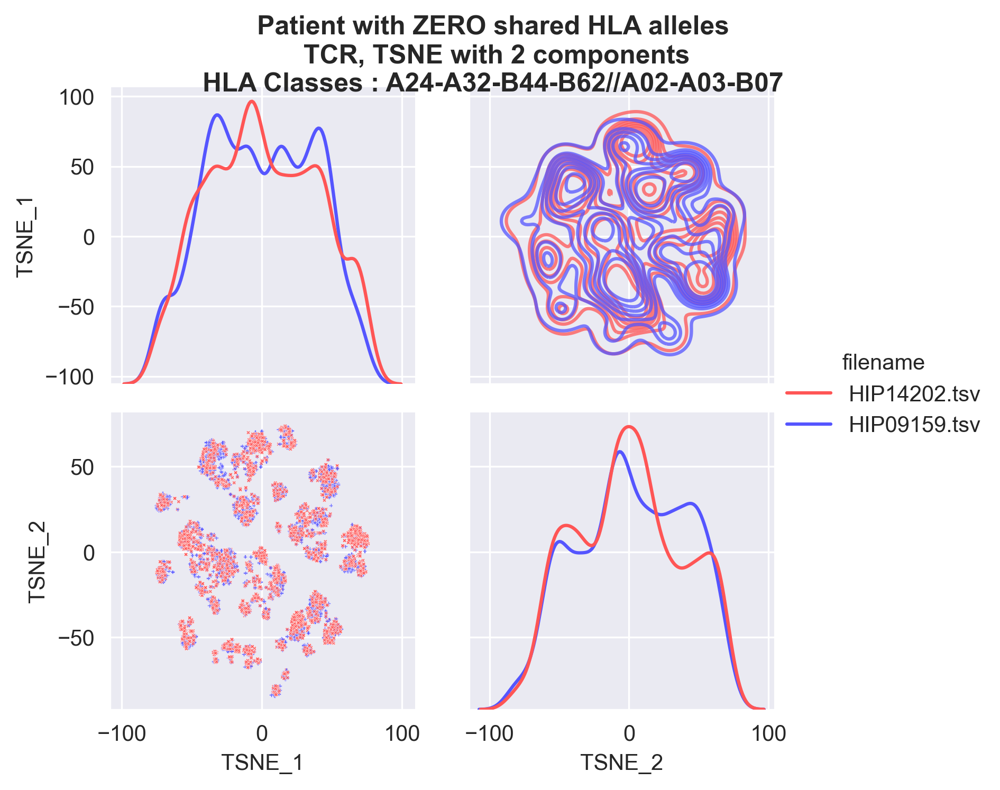

In [183]:
plot_reduc(tmp, hue = 'filename', 
           reduc = 'TSNE',
           name = 'Patient with ZERO shared HLA alleles\n',
           palette = 'seismic_r', comp=False)
plt.savefig(f'../../../meetings/presentation_results/210322_update/no_shared_HLA_top_3k_{reduc}_{masked}_{hue}.jpg', dpi = 300)